# Mental Health Capstone Project -- Exploratory Data Analysis
Here I will focus on  the mental and substance use disorders data. This data includes the share of population with different mental health disorders by country around the world. It includes a range of disorders including depression, anxiety, bipolar, eating disorders, schizophrenia, and alcohol and drug use disorders.

In [2]:
#load python packages
import os
import pandas as pd
import datetime
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline

In [3]:
# load the data
xls = pd.ExcelFile('data/mental_health_output_1.xlsx')
xls.sheet_names

['prevalence-by-mental-and-substa',
 'depression-by-level-of-educatio',
 'prevalence-of-depression-by-age',
 'prevalence-of-depression-males-',
 'suicide-rates-vs-prevalence-of-',
 'number-with-depression-by-count']

In [4]:
df1_types = pd.read_excel(xls, 'prevalence-by-mental-and-substa')

In [5]:
df1_types.head()

,Entity,Code,Year,Schizophrenia (%),Bipolar disorder (%),Eating disorders (%),Anxiety disorders (%),Drug use disorders (%),Depression (%),Alcohol use disorders (%)
0,Afghanistan,AFG,1990,0.160560,0.697779,0.101855,4.828830,1.677082,4.071831,0.672404
1,Afghanistan,AFG,1991,0.160312,0.697961,0.099313,4.829740,1.684746,4.079531,0.671768
2,Afghanistan,AFG,1992,0.160135,0.698107,0.096692,4.831108,1.694334,4.088358,0.670644
3,Afghanistan,AFG,1993,0.160037,0.698257,0.094336,4.830864,1.705320,4.096190,0.669738
4,Afghanistan,AFG,1994,0.160022,0.698469,0.092439,4.829423,1.716069,4.099582,0.669260


In [6]:
df1_types.Entity.nunique()

231

In [7]:
df1_types.Year.nunique()

28

## Build data profiles and tables

In [8]:
df1_types.describe()

,Year,Schizophrenia (%),Bipolar disorder (%),Eating disorders (%),Anxiety disorders (%),Drug use disorders (%),Depression (%),Alcohol use disorders (%)
count,6468.000000,6468.000000,6468.000000,6468.000000,6468.000000,6468.000000,6468.000000,6468.000000
mean,2003.500000,0.211644,0.719145,0.239998,3.989921,0.862278,3.497654,1.585821
std,8.078372,0.044253,0.171589,0.158141,1.167526,0.460679,0.655859,0.860283
min,1990.000000,0.146902,0.314535,0.073908,2.023393,0.383650,2.139903,0.446940
25%,1996.750000,0.181530,0.615532,0.122387,3.188824,0.535064,3.005529,0.993685
50%,2003.500000,0.199563,0.693134,0.182525,3.554373,0.726430,3.499606,1.479937
75%,2010.250000,0.236365,0.835063,0.292666,4.682163,0.940157,3.912381,1.867834
max,2017.000000,0.375110,1.206597,0.943991,8.967330,3.452476,6.602754,5.474668


* Here I notice that Anxiesty disorder and Depression present higher value.
* There is no big difference between mean and medium(50th percentile).
* There is a large difference between 75th percentile and max values for Drug and Alcohol use disorder.
* They suggest that Drug and Alcohol use disorder columns exist extreme values in this data set.

#### Reviewing for Outliers and Anamolies

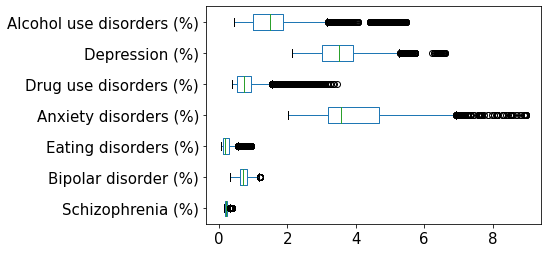

In [9]:
df1_types.drop(columns=['Year']).boxplot(grid=False, vert=False,fontsize=15)

It shows all columns have outliers with more 1.5×IQR above the third quartile. Let's check where the outliers located.

In [10]:
# Check where the outliers located

Q1 = df1_types.quantile(0.25)
Q3 = df1_types.quantile(0.75)
IQR = Q3 - Q1

# Outliers
df1_types_o = df1_types[((df1_types < (Q1 - 1.5 * IQR)) |(df1_types > (Q3 + 1.5 * IQR))).any(axis=1)]
df1_types_o.head()

,Entity,Code,Year,Schizophrenia (%),Bipolar disorder (%),Eating disorders (%),Anxiety disorders (%),Drug use disorders (%),Depression (%),Alcohol use disorders (%)
0,Afghanistan,AFG,1990,0.160560,0.697779,0.101855,4.828830,1.677082,4.071831,0.672404
1,Afghanistan,AFG,1991,0.160312,0.697961,0.099313,4.829740,1.684746,4.079531,0.671768
2,Afghanistan,AFG,1992,0.160135,0.698107,0.096692,4.831108,1.694334,4.088358,0.670644
3,Afghanistan,AFG,1993,0.160037,0.698257,0.094336,4.830864,1.705320,4.096190,0.669738
4,Afghanistan,AFG,1994,0.160022,0.698469,0.092439,4.829423,1.716069,4.099582,0.669260


In [11]:
df1_types_o.shape

(1396, 10)

In [12]:
df1_types.shape

(6468, 10)

In [13]:
df1_types_o.Entity.unique()

array(['Afghanistan', 'Algeria', 'Andorra', 'Australasia', 'Australia',
       'Austria', 'Bahrain', 'Belarus', 'Belgium', 'Brunei', 'Canada',
       'Central Europe, Eastern Europe, and Central Asia', 'China',
       'East Asia', 'Eastern Europe', 'El Salvador', 'England', 'Estonia',
       'Finland', 'France', 'Greece', 'Greenland', 'Guatemala',
       'High SDI', 'High-income', 'Iceland', 'Iran', 'Iraq', 'Ireland',
       'Italy', 'Jordan', 'Kazakhstan', 'Kuwait', 'Kyrgyzstan', 'Latvia',
       'Lebanon', 'Lesotho', 'Libya', 'Lithuania', 'Luxembourg',
       'Moldova', 'Mongolia', 'Morocco', 'Netherlands', 'New Zealand',
       'North Africa and Middle East', 'North America',
       'Northern Ireland', 'Norway', 'Oman', 'Qatar', 'Russia',
       'Saudi Arabia', 'Scotland', 'Singapore', 'Spain', 'Sweden',
       'Switzerland', 'Tunisia', 'Uganda', 'Ukraine',
       'United Arab Emirates', 'United Kingdom', 'United States', 'Wales',
       'Western Europe'], dtype=object)

<font color='red'>Q: 1. should I remove the outliers here? I foud some entities are not countries, like'High-income', I should find all of them and remove them?</font> 

In [14]:
df1_types_o.Year.unique()

array([1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000,
       2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011,
       2012, 2013, 2014, 2015, 2016, 2017], dtype=int64)

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x000002AA36218188>,
      dtype=object)

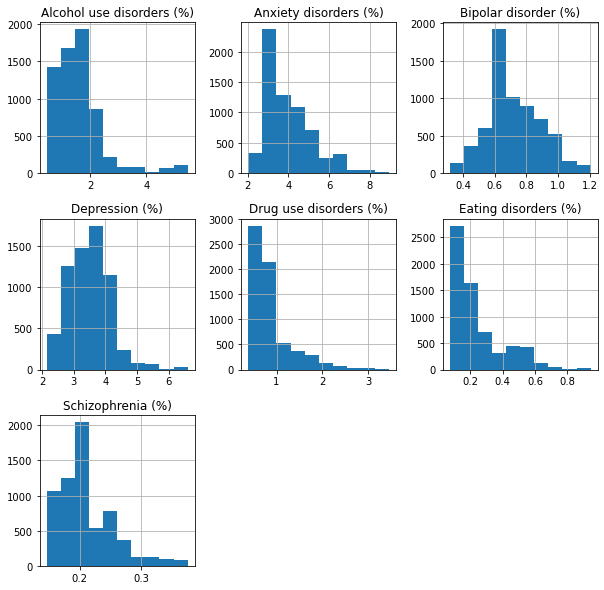

In [15]:
df1_types.drop(columns=['Year']).hist(figsize =(10,10))

Bipolar disorder column appears to be normally distributed. And remaining all variables are right skewed.

## Explore data relationships

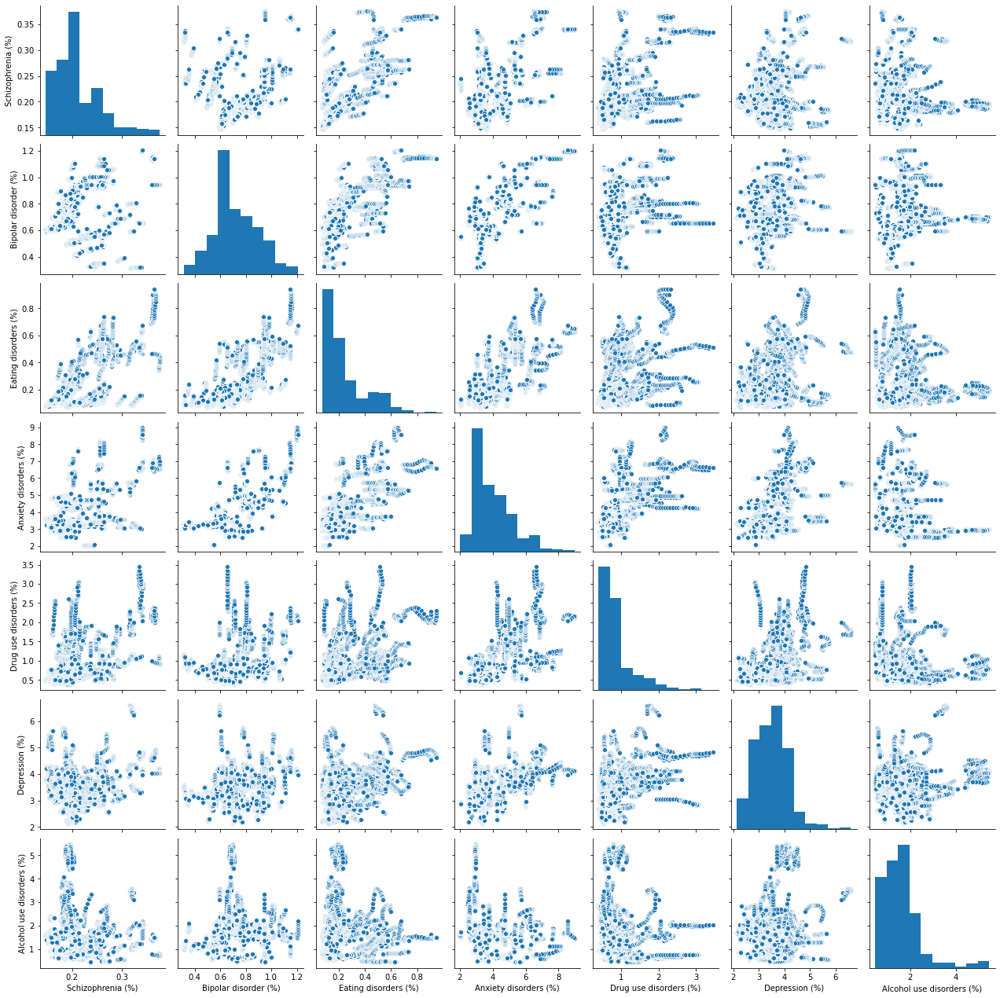

In [16]:
# Make a pairplot of the data with dropping 'Year' column
sns.pairplot(df1_types.drop(columns=['Year']))

(array([0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5]),
 <a list of 7 Text major ticklabel objects>)

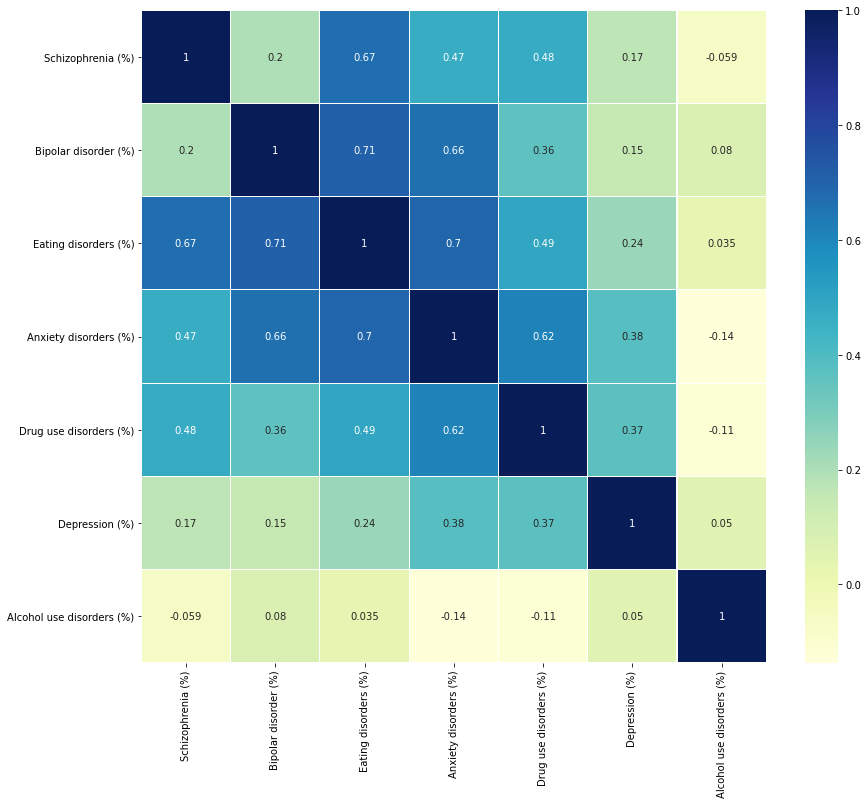

In [17]:
plt.figure(figsize=(14,12))
sns.heatmap(df1_types.drop(columns=['Year']).corr(),linewidths=.1,cmap="YlGnBu", annot=True)
plt.yticks(rotation=0)

From the pairplot and corrilation matrix we can infer:
* There is strong positive correlation between:
<ul>
<li>Schizophrenia and Eating disorder</li>
<li>Bipolar and Eating disorders</li>
<li>Bipolar and Anxiety disorders</li>
<li>Eating disorders and Anxiety</li>
<li>Anxiety and Drug use disorder</li>
</ul>
* There is negative corrilation between:
<ul>
<li>Alcohol use disorder and Schizophrenia</li>
<li>Alcohol use disorder and Anxiety disorders</li>
<li>Alcohol use disorder and Drug use disorder</li>
</ul>

In [18]:
# There are too many entried for each feature. Let's only foces on each year with the mean value next. 
# Group by 'Year' and take the mean for all contries
df1_types_year = df1_types.groupby(by='Year').mean()

In [19]:
df1_types_year.head()

,Schizophrenia (%),Bipolar disorder (%),Eating disorders (%),Anxiety disorders (%),Drug use disorders (%),Depression (%),Alcohol use disorders (%)
Year,,,,,,,
1990,0.209548,0.715392,0.221774,3.957269,0.808283,3.506288,1.546533
1991,0.209586,0.715740,0.222076,3.960009,0.813466,3.510948,1.553500
1992,0.209634,0.716091,0.222481,3.962778,0.818692,3.515033,1.559927
1993,0.209690,0.716430,0.223033,3.965405,0.823780,3.518531,1.565611
1994,0.209751,0.716755,0.223710,3.967976,0.828389,3.521437,1.570127


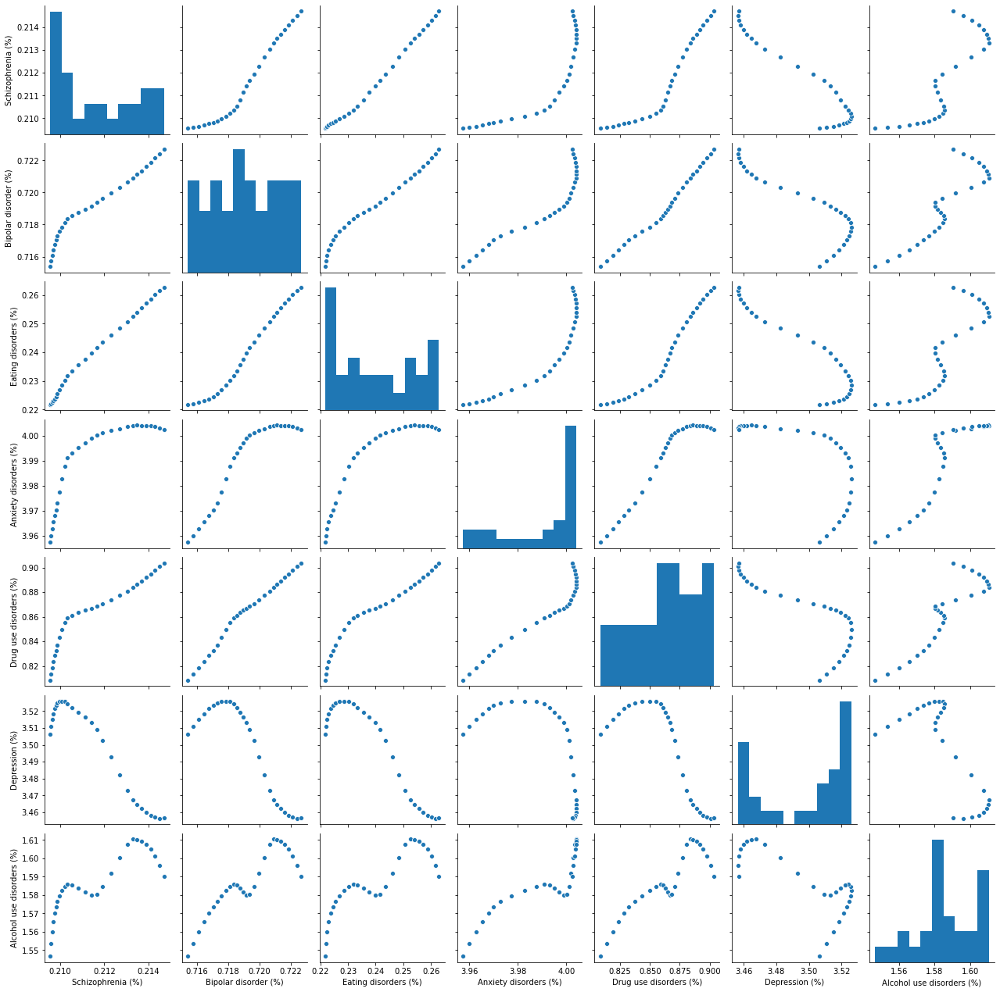

In [20]:
sns.pairplot(df1_types_year)

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x000002AA3999FFC8>,
      dtype=object)

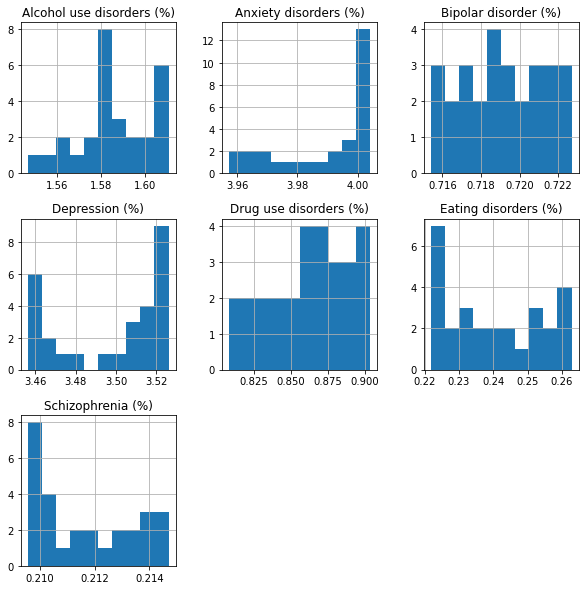

In [21]:
df1_types_year.hist(figsize =(10,10))

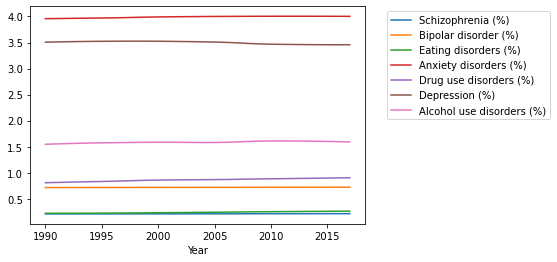

In [22]:
df1_types_year.plot()
plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.show()

* Depression rate slightly went down year by year. 
* Drug use disorder rate slightly went up year by year.
* Orther disorders didn't change that much.

(array([0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5]),
 <a list of 7 Text major ticklabel objects>)

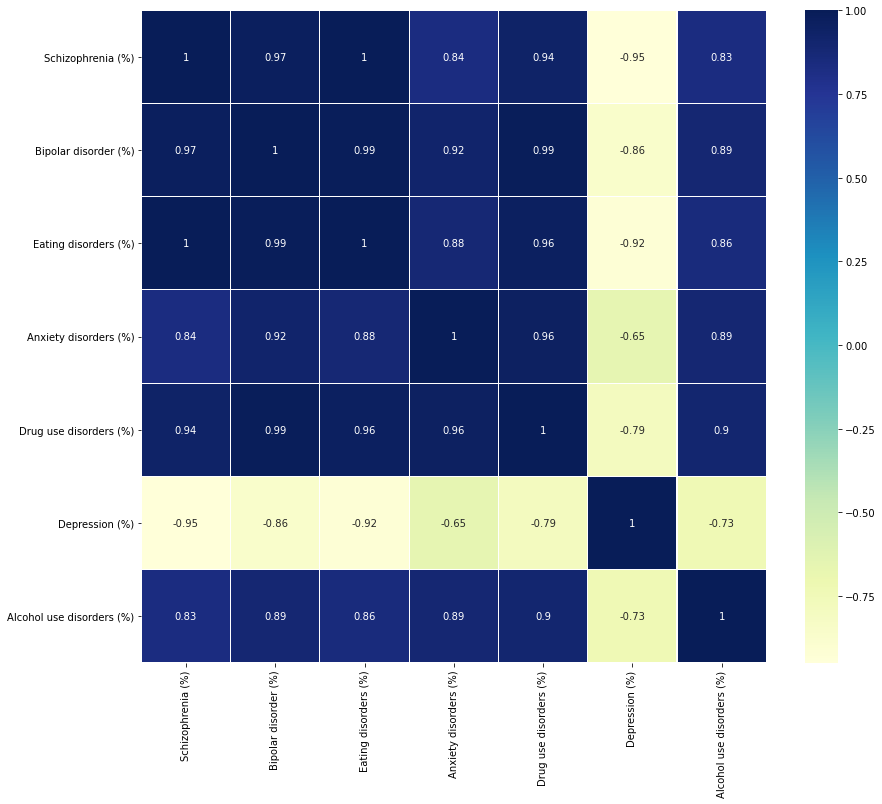

In [23]:
plt.figure(figsize=(14,12))
sns.heatmap(df1_types_year.corr(),linewidths=.1,cmap="YlGnBu", annot=True)
plt.yticks(rotation=0)

Interesting that Depression has strong negative corrilation with all other disorders. 

### Let's explore suicite rate data to check is there are relationships with these mental and substance use disorders.

In [24]:
df1_suicide = pd.read_excel(xls, 'suicide-rates-vs-prevalence-of-')

In [25]:
df1_suicide.head()

,Entity,Code,Year,"Suicide rate (deaths per 100,000 individuals)","Depressive disorder rates (number suffering per 100,000)",Population
0,Afghanistan,AFG,1990,10.318504,4039.755763,12412000
1,Afghanistan,AFG,1991,10.327010,4046.256034,13299000
2,Afghanistan,AFG,1992,10.271411,4053.709902,14486000
3,Afghanistan,AFG,1993,10.376123,4060.203474,15817000
4,Afghanistan,AFG,1994,10.575915,4062.290365,17076000


In [26]:
df1_suicide.describe()

,Year,"Suicide rate (deaths per 100,000 individuals)","Depressive disorder rates (number suffering per 100,000)",Population
count,5488.000000,5488.000000,5488.000000,5.488000e+03
mean,2003.500000,11.953749,3332.649855,6.556900e+07
std,8.078483,8.361615,636.103585,4.755855e+08
min,1990.000000,1.526792,2065.451870,4.500000e+04
25%,1996.750000,6.487754,2840.405347,1.726500e+06
50%,2003.500000,10.218074,3326.919130,6.832500e+06
75%,2010.250000,14.807193,3719.707955,2.176450e+07
max,2017.000000,98.831696,6096.437594,7.547859e+09


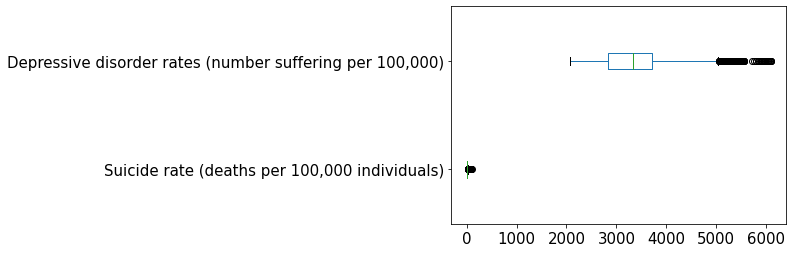

In [27]:
# The population will be huge different between countries, so I drop it here for the boxplot.
df1_suicide.drop(columns=['Year', 'Population']).boxplot(grid=False, vert=False,fontsize=15)

Depression disorder rates and Suicide rate columns all have outliers. 

Combine two datasets

In [28]:
df1_types_2 = df1_types.set_index(['Entity', 'Code', 'Year'])
df1_suicide_2 = df1_suicide.set_index(['Entity', 'Code','Year'])

In [29]:
data_frames = [df1_types_2, df1_suicide_2]
df_merged = pd.concat(data_frames, join='outer', axis=1).fillna(np.nan)
df_merged.head()

Schizophrenia (%)  Bipolar disorder (%)  \
Entity      Code Year                                            
Afghanistan AFG  1990           0.160560              0.697779   
                 1991           0.160312              0.697961   
                 1992           0.160135              0.698107   
                 1993           0.160037              0.698257   
                 1994           0.160022              0.698469   

                       Eating disorders (%)  Anxiety disorders (%)  \
Entity      Code Year                                                
Afghanistan AFG  1990              0.101855               4.828830   
                 1991              0.099313               4.829740   
                 1992              0.096692               4.831108   
                 1993              0.094336               4.830864   
                 1994              0.092439               4.829423   

                       Drug use disorders (%)  Depression (%)  \
Entity      Code Year                                           
Afghanistan AFG  1990                1.677082        4.071831   
                 1991                1.684746        4.079531   
                 1992                1.694334        4.088358   
                 1993                1.705320        4.096190   
                 1994                1.716069        4.099582   

                       Alcohol use disorders (%)  \
Entity      Code Year                              
Afghanistan AFG  1990                   0.672404   
                 1991                   0.671768   
                 1992                   0.670644   
                 1993                   0.669738   
                 1994                   0.669260   

                       Suicide rate (deaths per 100,000 individuals)  \
Entity      Code Year                                                  
Afghanistan AFG  1990                                      10.318504   
                 1991                                      10.327010   
                 1992                                      10.271411   
                 1993                                      10.376123   
                 1994                                      10.575915   

                       Depressive disorder rates (number suffering per 100,000)  \
Entity      Code Year                                                             
Afghanistan AFG  1990                                        4039.755763          
                 1991                                        4046.256034          
                 1992                                        4053.709902          
                 1993                                        4060.203474          
                 1994                                        4062.290365          

                       Population  
Entity      Code Year              
Afghanistan AFG  1990  12412000.0  
                 1991  13299000.0  
                 1992  14486000.0  
                 1993  15817000.0  
                 1994  17076000.0

In [30]:
df_merged.info()

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 6468 entries, ('Afghanistan', 'AFG', 1990) to ('Zimbabwe', 'ZWE', 2017)
Data columns (total 10 columns):
 #   Column                                                    Non-Null Count  Dtype  
---  ------                                                    --------------  -----  
 0   Schizophrenia (%)                                         6468 non-null   float64
 1   Bipolar disorder (%)                                      6468 non-null   float64
 2   Eating disorders (%)                                      6468 non-null   float64
 3   Anxiety disorders (%)                                     6468 non-null   float64
 4   Drug use disorders (%)                                    6468 non-null   float64
 5   Depression (%)                                            6468 non-null   float64
 6   Alcohol use disorders (%)                                 6468 non-null   float64
 7   Suicide rate (deaths per 100,000 individuals)            

In [31]:
# check the null rows
df_na = df_merged[df_merged.isna().any(axis=1)]
df_na

Schizophrenia (%)  Bipolar disorder (%)  \
Entity                     Code Year                                            
Andean Latin America       NaN  1990           0.195471              0.870564   
                                1991           0.195484              0.870876   
                                1992           0.195497              0.871174   
                                1993           0.195523              0.871482   
                                1994           0.195569              0.871823   
...                                                 ...                   ...   
Western Sub-Saharan Africa NaN  2013           0.173905              0.635737   
                                2014           0.174254              0.636185   
                                2015           0.174616              0.636682   
                                2016           0.174980              0.637211   
                                2017           0.175340              0.637776   

                                      Eating disorders (%)  \
Entity                     Code Year                         
Andean Latin America       NaN  1990              0.287820   
                                1991              0.289362   
                                1992              0.290563   
                                1993              0.291833   
                                1994              0.293111   
...                                                    ...   
Western Sub-Saharan Africa NaN  2013              0.136469   
                                2014              0.138116   
                                2015              0.139784   
                                2016              0.141193   
                                2017              0.142431   

                                      Anxiety disorders (%)  \
Entity                     Code Year                          
Andean Latin America       NaN  1990               4.217677   
                                1991               4.220261   
                                1992               4.222587   
                                1993               4.224721   
                                1994               4.226690   
...                                                     ...   
Western Sub-Saharan Africa NaN  2013               2.899641   
                                2014               2.902038   
                                2015               2.904311   
                                2016               2.906350   
                                2017               2.908183   

                                      Drug use disorders (%)  Depression (%)  \
Entity                     Code Year                                           
Andean Latin America       NaN  1990                0.608921        2.621781   
                                1991                0.610489        2.631717   
                                1992                0.611990        2.639932   
                                1993                0.613995        2.646096   
                                1994                0.616448        2.651022   
...                                                      ...             ...   
Western Sub-Saharan Africa NaN  2013                0.477964        3.805780   
                                2014                0.480415        3.787750   
                                2015                0.482921        3.762850   
                                2016                0.485547        3.733871   
                                2017                0.488562        3.699654   

                                      Alcohol use disorders (%)  \
Entity                     Code Year                              
Andean Latin America       NaN  1990                   1.748912   
                                1991                   1.743910   
                                1992            

In [32]:
# I was going to check the unique entity in null values data, but this method seems not working well
df_na.index.levels[0]

Index(['Afghanistan', 'Albania', 'Algeria', 'American Samoa',
       'Andean Latin America', 'Andorra', 'Angola', 'Antigua and Barbuda',
       'Argentina', 'Armenia',
       ...
       'Vanuatu', 'Venezuela', 'Vietnam', 'Wales', 'Western Europe',
       'Western Sub-Saharan Africa', 'World', 'Yemen', 'Zambia', 'Zimbabwe'],
      dtype='object', name='Entity', length=231)

In [33]:
# Check the unique value of entity
df_na_1 = df_na.reset_index()
df_na_1.Entity.unique()

array(['Andean Latin America', 'Australasia', 'Caribbean', 'Central Asia',
       'Central Europe',
       'Central Europe, Eastern Europe, and Central Asia',
       'Central Latin America', 'Central Sub-Saharan Africa', 'East Asia',
       'Eastern Europe', 'Eastern Sub-Saharan Africa', 'England',
       'High SDI', 'High-income', 'High-income Asia Pacific',
       'High-middle SDI', 'Latin America and Caribbean', 'Low SDI',
       'Low-middle SDI', 'Middle SDI', 'North Africa and Middle East',
       'North America', 'Northern Ireland', 'Oceania', 'Scotland',
       'South Asia', 'Southeast Asia',
       'Southeast Asia, East Asia, and Oceania', 'Southern Latin America',
       'Southern Sub-Saharan Africa', 'Sub-Saharan Africa',
       'Tropical Latin America', 'Wales', 'Western Europe',
       'Western Sub-Saharan Africa'], dtype=object)

It looks like most Entities in the null data are region, not coutry. We can drop those data. 

In [34]:
df_merged.dropna(inplace=True)
df_merged.info()

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 5488 entries, ('Afghanistan', 'AFG', 1990) to ('Zimbabwe', 'ZWE', 2017)
Data columns (total 10 columns):
 #   Column                                                    Non-Null Count  Dtype  
---  ------                                                    --------------  -----  
 0   Schizophrenia (%)                                         5488 non-null   float64
 1   Bipolar disorder (%)                                      5488 non-null   float64
 2   Eating disorders (%)                                      5488 non-null   float64
 3   Anxiety disorders (%)                                     5488 non-null   float64
 4   Drug use disorders (%)                                    5488 non-null   float64
 5   Depression (%)                                            5488 non-null   float64
 6   Alcohol use disorders (%)                                 5488 non-null   float64
 7   Suicide rate (deaths per 100,000 individuals)            

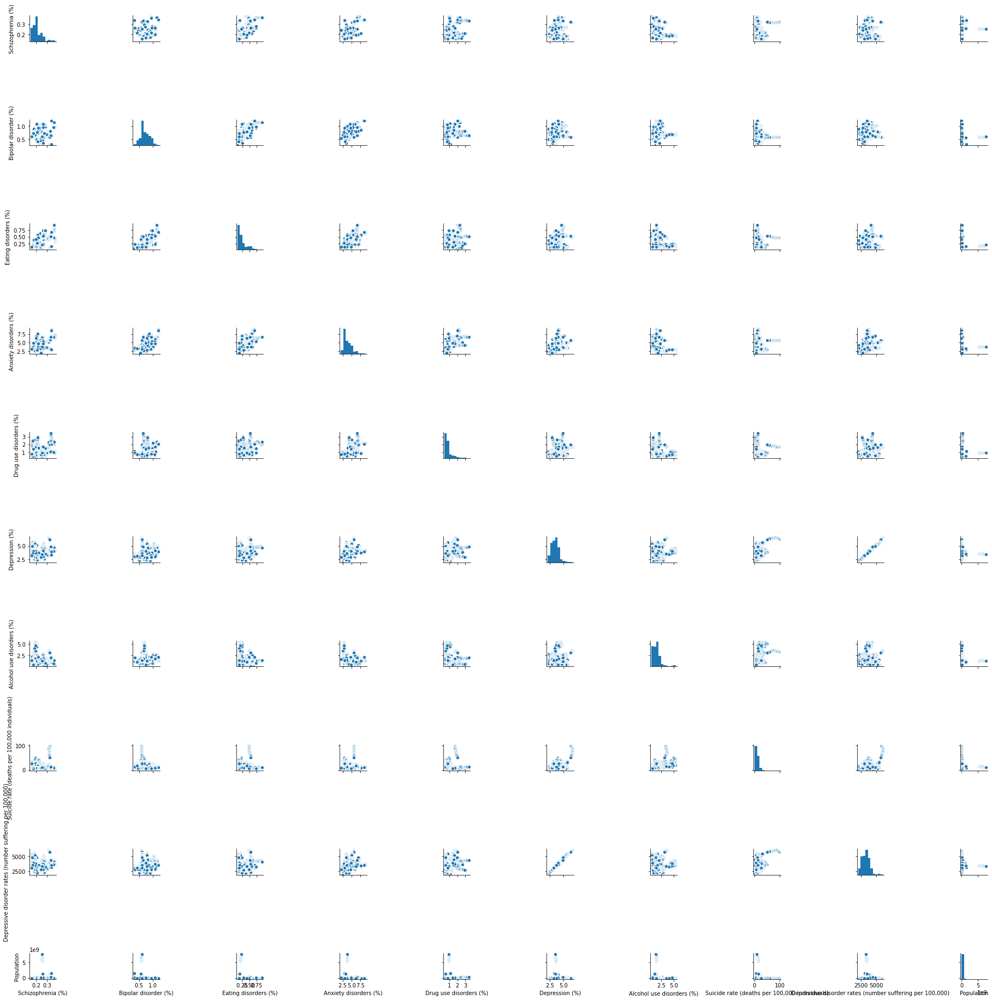

In [35]:
sns.pairplot(df_merged)

(array([0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5, 8.5, 9.5]),
 <a list of 10 Text major ticklabel objects>)

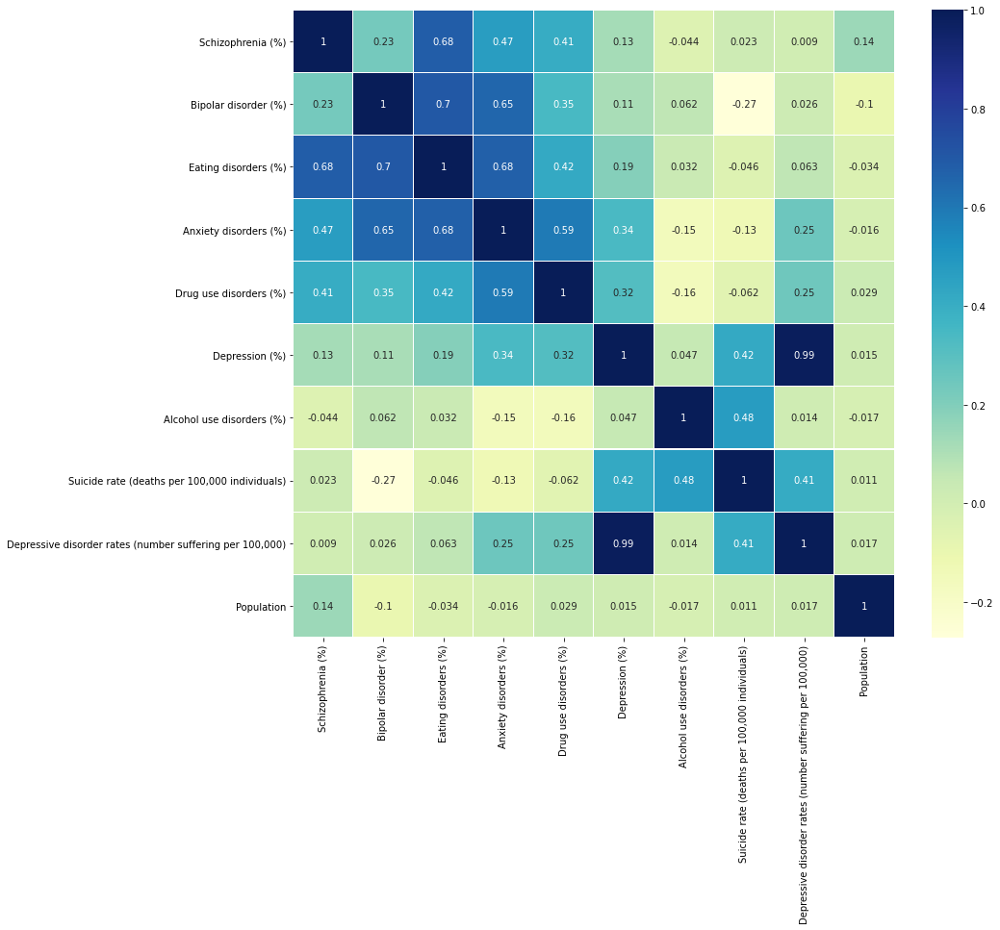

In [36]:
plt.figure(figsize=(14,12))
sns.heatmap(df_merged.corr(),linewidths=.1,cmap="YlGnBu", annot=True)
plt.yticks(rotation=0)

The suicide rate shows positive corrilation with Depression and Alcohol use disorders. Let's take a closer look at the relationships between them.

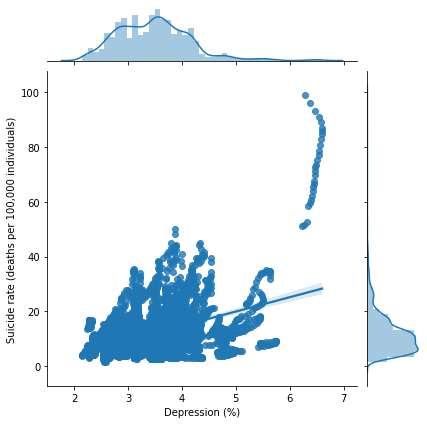

In [37]:
# Plot the relationship between suicide rate and Depression
sns.jointplot(x='Depression (%)', y='Suicide rate (deaths per 100,000 individuals)', data=df_merged, kind="reg")

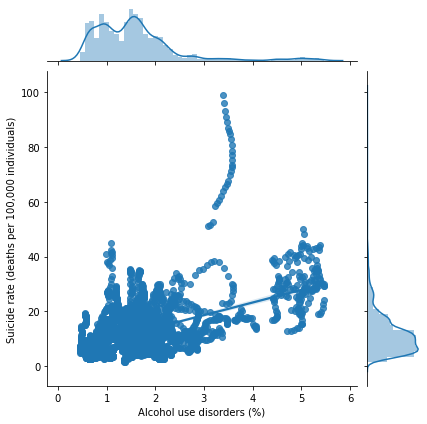

In [38]:
# plot the realationship between suicide rate and Alcocol
sns.jointplot(x='Alcohol use disorders (%)', y='Suicide rate (deaths per 100,000 individuals)', data=df_merged, kind="reg")

### Remove the ouliers to check the relationship again.

In [39]:
# drop the outliers
Q1 = df1_suicide.quantile(0.25)
 
Q3 = df1_suicide.quantile(0.75)

IQR = Q3 - Q1
# Not outliers
df1_suicide_no = df1_suicide[~((df1_suicide < (Q1 - 1.5 * IQR)) |(df1_suicide > (Q3 + 1.5 * IQR))).any(axis=1)]
df1_suicide_no.head()

,Entity,Code,Year,"Suicide rate (deaths per 100,000 individuals)","Depressive disorder rates (number suffering per 100,000)",Population
0,Afghanistan,AFG,1990,10.318504,4039.755763,12412000
1,Afghanistan,AFG,1991,10.327010,4046.256034,13299000
2,Afghanistan,AFG,1992,10.271411,4053.709902,14486000
3,Afghanistan,AFG,1993,10.376123,4060.203474,15817000
4,Afghanistan,AFG,1994,10.575915,4062.290365,17076000


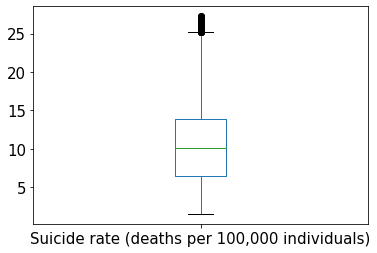

In [40]:
df1_suicide_no[['Suicide rate (deaths per 100,000 individuals)']].boxplot(grid=False, fontsize=15)

In [41]:
df1_types_3 = df1_types.set_index(['Entity', 'Code', 'Year'])
df1_suicide_3 = df1_suicide_no.set_index(['Entity', 'Code','Year'])

In [42]:
data_frames_2 = [df1_types_3, df1_suicide_3]
df_merged_2 = pd.concat(data_frames_2, join='outer', axis=1).fillna(np.nan)
df_merged_2.head()

Schizophrenia (%)  Bipolar disorder (%)  \
Entity      Code Year                                            
Afghanistan AFG  1990           0.160560              0.697779   
                 1991           0.160312              0.697961   
                 1992           0.160135              0.698107   
                 1993           0.160037              0.698257   
                 1994           0.160022              0.698469   

                       Eating disorders (%)  Anxiety disorders (%)  \
Entity      Code Year                                                
Afghanistan AFG  1990              0.101855               4.828830   
                 1991              0.099313               4.829740   
                 1992              0.096692               4.831108   
                 1993              0.094336               4.830864   
                 1994              0.092439               4.829423   

                       Drug use disorders (%)  Depression (%)  \
Entity      Code Year                                           
Afghanistan AFG  1990                1.677082        4.071831   
                 1991                1.684746        4.079531   
                 1992                1.694334        4.088358   
                 1993                1.705320        4.096190   
                 1994                1.716069        4.099582   

                       Alcohol use disorders (%)  \
Entity      Code Year                              
Afghanistan AFG  1990                   0.672404   
                 1991                   0.671768   
                 1992                   0.670644   
                 1993                   0.669738   
                 1994                   0.669260   

                       Suicide rate (deaths per 100,000 individuals)  \
Entity      Code Year                                                  
Afghanistan AFG  1990                                      10.318504   
                 1991                                      10.327010   
                 1992                                      10.271411   
                 1993                                      10.376123   
                 1994                                      10.575915   

                       Depressive disorder rates (number suffering per 100,000)  \
Entity      Code Year                                                             
Afghanistan AFG  1990                                        4039.755763          
                 1991                                        4046.256034          
                 1992                                        4053.709902          
                 1993                                        4060.203474          
                 1994                                        4062.290365          

                       Population  
Entity      Code Year              
Afghanistan AFG  1990  12412000.0  
                 1991  13299000.0  
                 1992  14486000.0  
                 1993  15817000.0  
                 1994  17076000.0

In [43]:
df_merged_2.info()

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 6468 entries, ('Afghanistan', 'AFG', 1990) to ('Zimbabwe', 'ZWE', 2017)
Data columns (total 10 columns):
 #   Column                                                    Non-Null Count  Dtype  
---  ------                                                    --------------  -----  
 0   Schizophrenia (%)                                         6468 non-null   float64
 1   Bipolar disorder (%)                                      6468 non-null   float64
 2   Eating disorders (%)                                      6468 non-null   float64
 3   Anxiety disorders (%)                                     6468 non-null   float64
 4   Drug use disorders (%)                                    6468 non-null   float64
 5   Depression (%)                                            6468 non-null   float64
 6   Alcohol use disorders (%)                                 6468 non-null   float64
 7   Suicide rate (deaths per 100,000 individuals)            

In [44]:
df_merged_2.dropna(inplace=True)
df_merged_2.info()

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 4536 entries, ('Afghanistan', 'AFG', 1990) to ('Zimbabwe', 'ZWE', 2017)
Data columns (total 10 columns):
 #   Column                                                    Non-Null Count  Dtype  
---  ------                                                    --------------  -----  
 0   Schizophrenia (%)                                         4536 non-null   float64
 1   Bipolar disorder (%)                                      4536 non-null   float64
 2   Eating disorders (%)                                      4536 non-null   float64
 3   Anxiety disorders (%)                                     4536 non-null   float64
 4   Drug use disorders (%)                                    4536 non-null   float64
 5   Depression (%)                                            4536 non-null   float64
 6   Alcohol use disorders (%)                                 4536 non-null   float64
 7   Suicide rate (deaths per 100,000 individuals)            

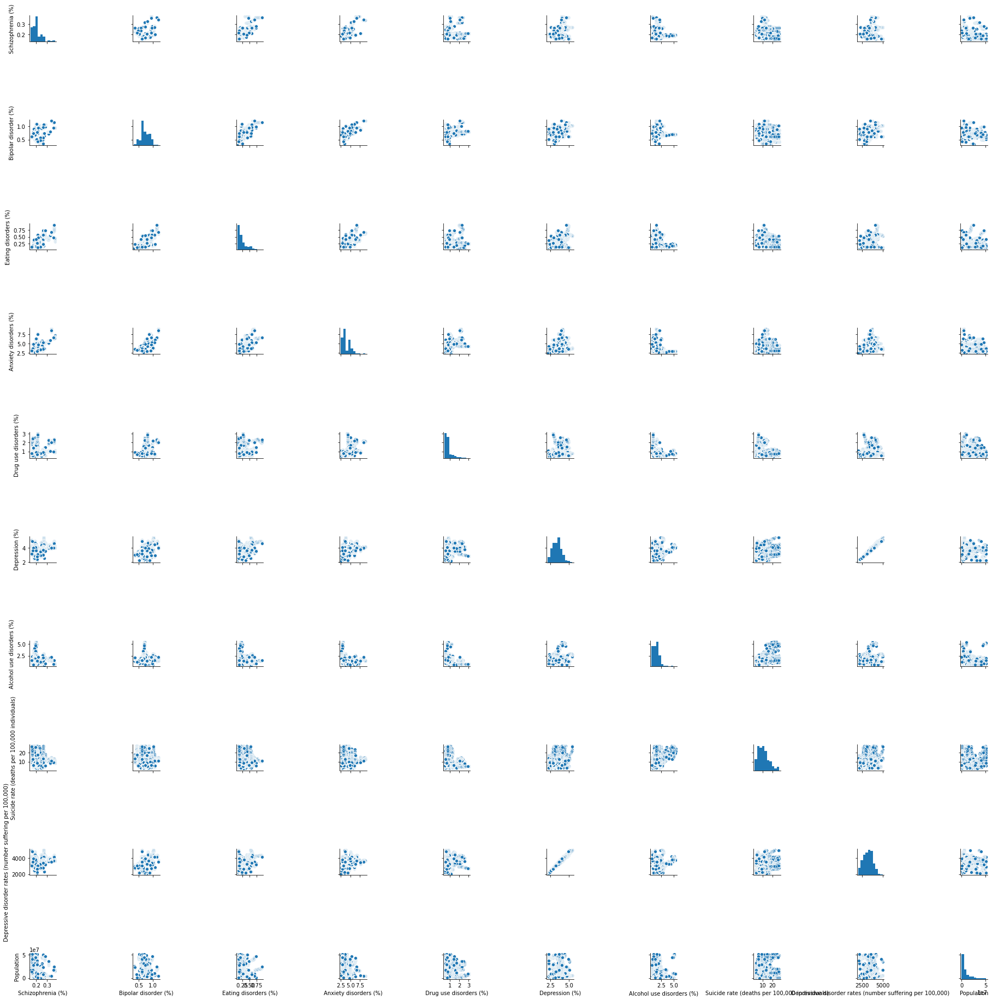

In [45]:
sns.pairplot(df_merged_2)

(array([0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5, 8.5, 9.5]),
 <a list of 10 Text major ticklabel objects>)

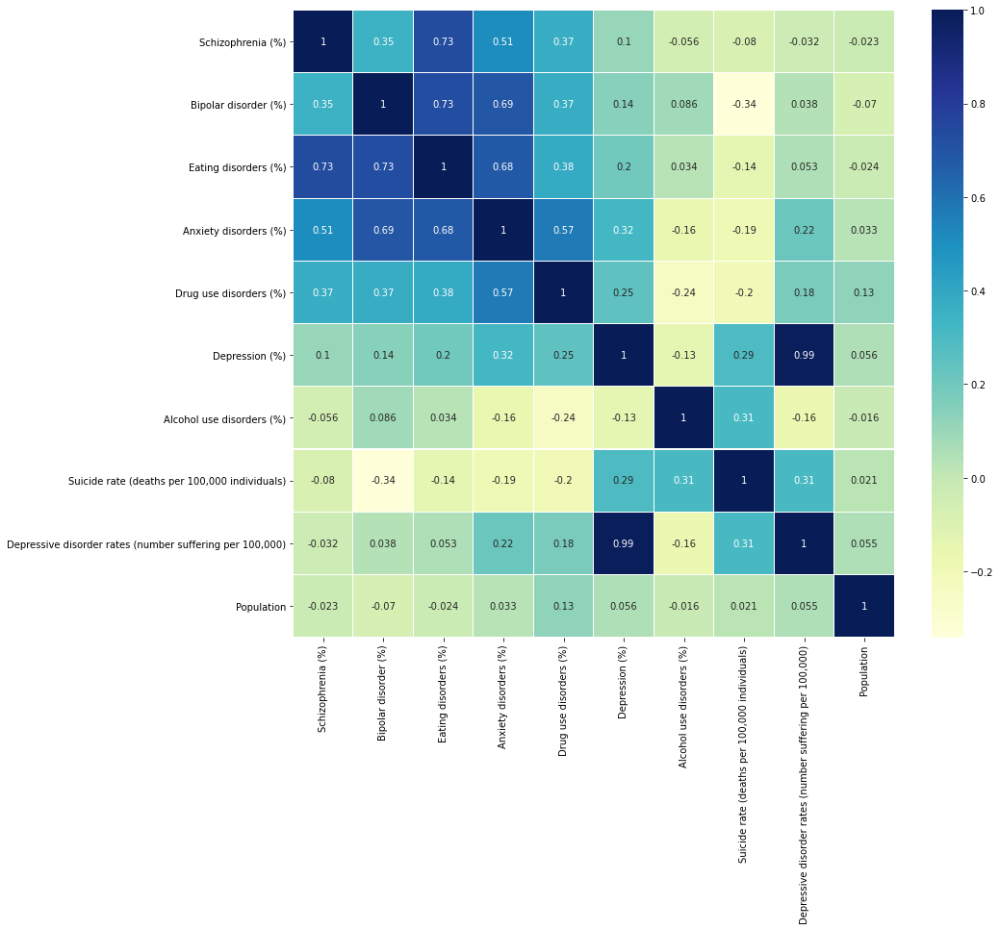

In [46]:
plt.figure(figsize=(14,12))
sns.heatmap(df_merged_2.corr(),linewidths=.1,cmap="YlGnBu", annot=True)
plt.yticks(rotation=0)

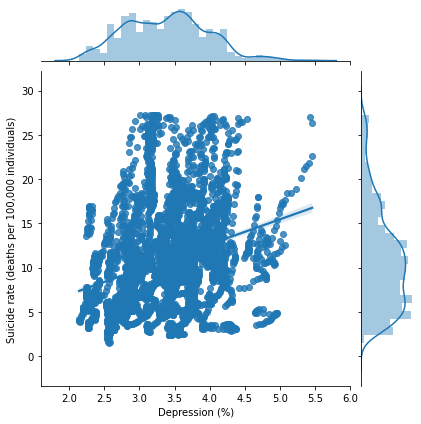

In [47]:
# Plot the relationship between suicide rate and Depression
sns.jointplot(x='Depression (%)', y='Suicide rate (deaths per 100,000 individuals)', data=df_merged_2, kind="reg")

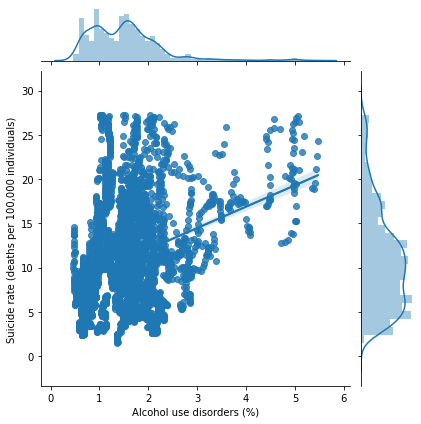

In [48]:
# plot the realationship between suicide rate and Alcocol
sns.jointplot(x='Alcohol use disorders (%)', y='Suicide rate (deaths per 100,000 individuals)', data=df_merged_2, kind="reg")

After removing the outliers from suicide data, the corrilation between suicide rate and Depression and between suicide rate Alcohol use disorders lower. From the figurs above we can infer that there is no linear relationship between suicide rate and Depression and between suicide rate Alcohol use disorders. 

## The following data is depression rate by age, gender and education and employment state.
Depression also called major depressive disorder. It causes a ferling of sadness and loss of interest, and affects how you feel, think and behave. It happends to all ages and ang genders.

### explore the age data

In [49]:
df1_age = pd.read_excel(xls, 'prevalence-of-depression-by-age')

In [50]:
df1_age.head()

,Entity,Code,Year,20-24 years old (%),10-14 years old (%),All ages (%),70+ years old (%),30-34 years old (%),15-19 years old (%),25-29 years old (%),50-69 years old (%),Age-standardized (%),15-49 years old (%)
0,Afghanistan,AFG,1990,4.417802,1.594676,3.218871,5.202803,5.799034,3.455708,5.175856,5.917752,4.071831,4.939766
1,Afghanistan,AFG,1991,4.433524,1.588356,3.203468,5.192849,5.814828,3.451880,5.176729,5.927093,4.079531,4.902682
2,Afghanistan,AFG,1992,4.453689,1.577980,3.156559,5.176872,5.829745,3.434982,5.160249,5.945656,4.088358,4.837097
3,Afghanistan,AFG,1993,4.464517,1.577201,3.120655,5.167355,5.853060,3.420210,5.148767,5.966915,4.096190,4.813657
4,Afghanistan,AFG,1994,4.462960,1.570846,3.082179,5.157549,5.852851,3.425222,5.148227,5.975907,4.099582,4.839340


In [51]:
# rearrange the columns by age asscendig order
cols = df1_age.columns.tolist()
cols

['Entity',
 'Code',
 'Year',
 '20-24 years old (%)',
 '10-14 years old (%)',
 'All ages (%)',
 '70+ years old (%)',
 '30-34 years old (%)',
 '15-19 years old (%)',
 '25-29 years old (%)',
 '50-69 years old (%)',
 'Age-standardized (%)',
 '15-49 years old (%)']

In [52]:
cols = ['Entity',
 'Code',
 'Year',
 '10-14 years old (%)',
 '15-19 years old (%)',
 '20-24 years old (%)',
 '25-29 years old (%)',
 '30-34 years old (%)',
 '15-49 years old (%)', 
 '50-69 years old (%)',
 '70+ years old (%)',
 'All ages (%)',
 'Age-standardized (%)',
 ]

In [53]:
df1_age = df1_age[cols]
df1_age.head()

,Entity,Code,Year,10-14 years old (%),15-19 years old (%),20-24 years old (%),25-29 years old (%),30-34 years old (%),15-49 years old (%),50-69 years old (%),70+ years old (%),All ages (%),Age-standardized (%)
0,Afghanistan,AFG,1990,1.594676,3.455708,4.417802,5.175856,5.799034,4.939766,5.917752,5.202803,3.218871,4.071831
1,Afghanistan,AFG,1991,1.588356,3.451880,4.433524,5.176729,5.814828,4.902682,5.927093,5.192849,3.203468,4.079531
2,Afghanistan,AFG,1992,1.577980,3.434982,4.453689,5.160249,5.829745,4.837097,5.945656,5.176872,3.156559,4.088358
3,Afghanistan,AFG,1993,1.577201,3.420210,4.464517,5.148767,5.853060,4.813657,5.966915,5.167355,3.120655,4.096190
4,Afghanistan,AFG,1994,1.570846,3.425222,4.462960,5.148227,5.852851,4.839340,5.975907,5.157549,3.082179,4.099582


In [54]:
df1_age.describe()

,Year,10-14 years old (%),15-19 years old (%),20-24 years old (%),25-29 years old (%),30-34 years old (%),15-49 years old (%),50-69 years old (%),70+ years old (%),All ages (%),Age-standardized (%)
count,6468.000000,6468.000000,6468.000000,6468.000000,6468.000000,6468.000000,6468.000000,6468.000000,6468.000000,6468.000000,6468.000000
mean,2003.500000,1.376053,3.076291,3.788878,3.913513,4.076232,4.016824,5.662794,6.137538,3.279958,3.497654
std,8.078372,0.404854,0.857978,1.075230,1.026875,1.030536,0.967864,1.020436,1.501730,0.861814,0.655859
min,1990.000000,0.710318,1.497964,1.718949,1.946369,2.231433,2.177050,3.248216,3.249315,1.805876,2.139903
25%,1996.750000,1.066155,2.529356,3.071424,3.172756,3.248436,3.316308,4.862645,4.874158,2.609811,3.005529
50%,2003.500000,1.259560,2.895936,3.528323,3.722521,3.969812,3.850302,5.621947,5.928127,3.031299,3.499606
75%,2010.250000,1.589738,3.415008,4.309666,4.488815,4.725525,4.597567,6.416751,7.361696,3.793446,3.912381
max,2017.000000,3.303273,9.053459,11.275973,10.377815,9.684816,9.626314,9.777747,11.531880,6.990122,6.602754


* From mean value, we can see that the depression rate increaseed with age. 
* People who are older than 70 years old more likely have depression (with highest depression rate). 
* People who are between 10 to 14 years old shows lower depression rate.

Visulize the depression trend with age

In [55]:
df1_age_mean = df1_age.describe().T[['mean']]
df1_age_mean

,mean
Year,2003.500000
10-14 years old (%),1.376053
15-19 years old (%),3.076291
20-24 years old (%),3.788878
25-29 years old (%),3.913513
30-34 years old (%),4.076232
15-49 years old (%),4.016824
50-69 years old (%),5.662794
70+ years old (%),6.137538
All ages (%),3.279958


In [56]:
df = df1_age_mean.drop(df1_age_mean.index[[0, 9, 10]])

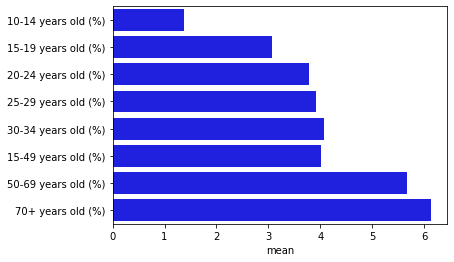

In [57]:
sns.barplot(x='mean', y=df.index, data=df, color='b')

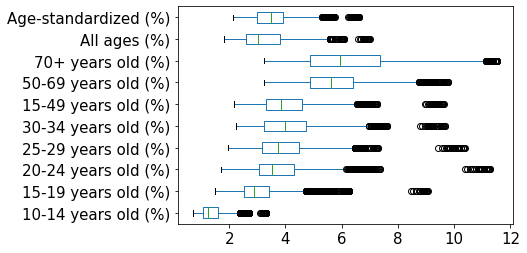

In [58]:
# check the outliers
df1_age.drop(columns=['Year']).boxplot(grid=False, vert=False,fontsize=15)

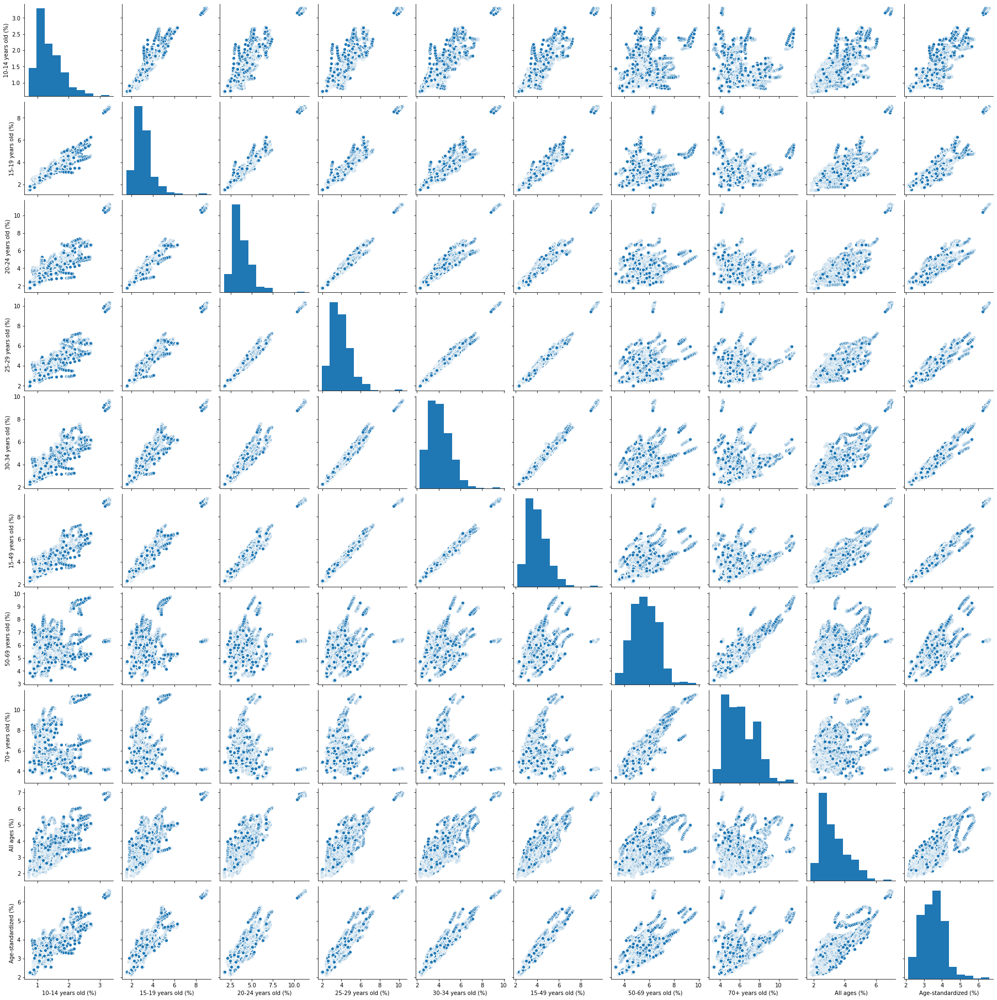

In [59]:
sns.pairplot(df1_age.drop(columns=['Year']))

(array([0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5, 8.5, 9.5]),
 <a list of 10 Text major ticklabel objects>)

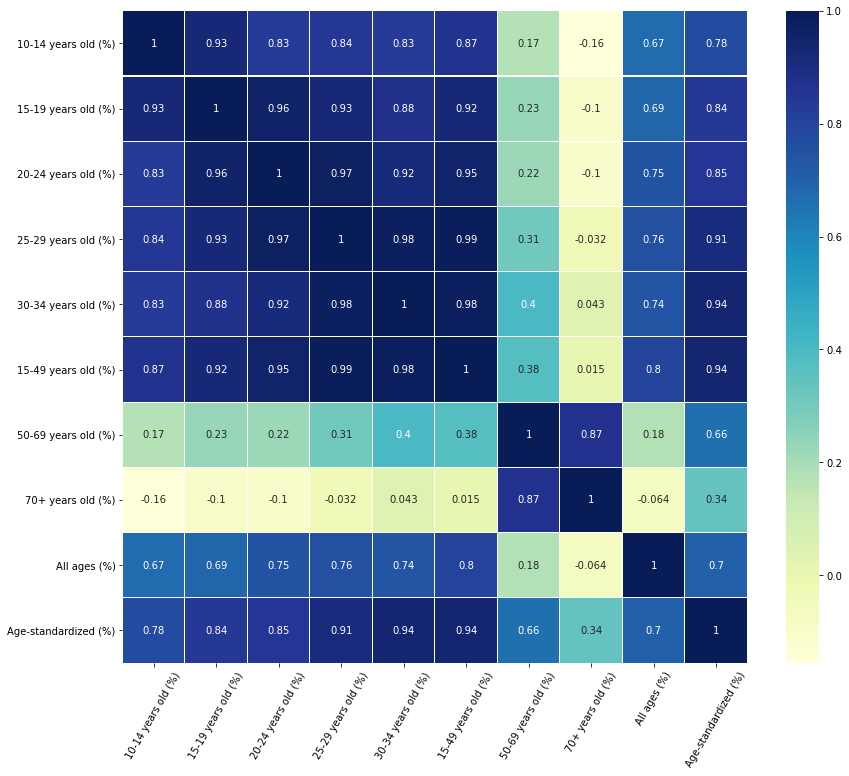

In [60]:
plt.figure(figsize=(14,12))
sns.heatmap(df1_age.drop(columns=['Year']).corr(),linewidths=.1,cmap="YlGnBu", annot=True)
plt.yticks(rotation=0)
plt.xticks(rotation=60)

* People who older than 50 years old has lower corrilation with younger people. 
* But 50-69 and 70+ have strong positive corrilation. 
* Younger people who is under 49 years old has strong corrilation with each other. 

### explore the gender data

In [61]:
df1_gender = pd.read_excel(xls, 'prevalence-of-depression-males-')

In [62]:
df1_gender.head()

,Entity,Code,Year,Prevalence in males (%),Prevalence in females (%),Population
0,Afghanistan,AFG,1990,3.499982,4.647815,12412000
1,Afghanistan,AFG,1991,3.503947,4.655772,13299000
2,Afghanistan,AFG,1992,3.508912,4.662066,14486000
3,Afghanistan,AFG,1993,3.513429,4.669012,15817000
4,Afghanistan,AFG,1994,3.515578,4.673050,17076000


In [63]:
df1_gender.describe()

,Year,Prevalence in males (%),Prevalence in females (%),Population
count,5488.000000,5488.000000,5488.000000,5.488000e+03
mean,2003.500000,2.795804,4.124004,6.556900e+07
std,8.078483,0.551855,0.858590,4.755855e+08
min,1990.000000,1.594129,2.348094,4.500000e+04
25%,1996.750000,2.396062,3.483078,1.726500e+06
50%,2003.500000,2.751712,4.159839,6.832500e+06
75%,2010.250000,3.111382,4.590900,2.176450e+07
max,2017.000000,4.905163,8.537801,7.547859e+09


* From mean value, we can see that depression is more common for wommen than men. 

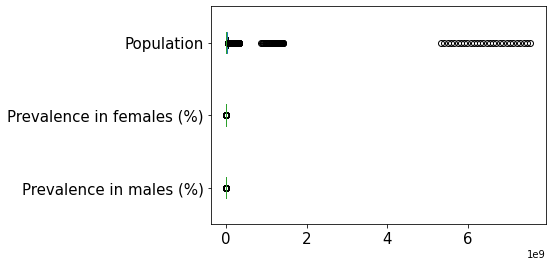

In [64]:
df1_gender.drop(columns=['Year']).boxplot(grid=False, vert=False,fontsize=15)

### explore 'Depression by education level & employment status' data
This dataset is based only on adults aged 25-64 years old, and focuses on self-reported depression only.

In [90]:
df1_edu_2014 = pd.read_excel(xls, 'depression-by-level-of-educatio')
df1_edu_2014.head()

,Entity,Code,Year,All levels (active) (%),All levels (employed) (%),All levels (total) (%),Below upper secondary (active) (%),Below upper secondary (employed) (%),Below upper secondary (total) (%),Tertiary (active) (%),Tertiary (employed) (%),Tertiary (total) (%),Upper secondary & post-secondary non-tertiary (active) (%),Upper secondary & post-secondary non-tertiary (employed) (%),Upper secondary & post-secondary non-tertiary (total) (%)
0,Austria,AUT,2014,6.5,4.7,7.7,15.5,9.0,15.2,4.3,3.5,5.5,5.5,4.2,6.7
1,Belgium,BEL,2014,5.0,4.1,7.1,7.1,4.8,11.6,3.7,3.3,4.2,5.7,5.0,7.5
2,Czech Republic,CZE,2014,3.0,2.6,4.0,2.1,2.5,6.0,1.7,1.7,2.0,3.5,3.0,4.4
3,Denmark,DNK,2014,6.7,5.7,8.3,10.4,6.5,15.5,5.7,4.7,6.7,7.4,6.9,8.8
4,Estonia,EST,2014,3.8,3.8,5.1,4.7,4.7,6.4,3.6,3.6,4.3,3.7,3.8,5.2


* employed: whether groups are employed
* active: actively seeking employment
* total: the total of employed, active and unemployed.

From the data we can see the total column doesn't match what it described which should be more than sum of employed and active. But we still can see some insights between depression and education & employment status from employed and active columns. 

In [91]:
df1_edu_2014.describe()

,Year,All levels (active) (%),All levels (employed) (%),All levels (total) (%),Below upper secondary (active) (%),Below upper secondary (employed) (%),Below upper secondary (total) (%),Tertiary (active) (%),Tertiary (employed) (%),Tertiary (total) (%),Upper secondary & post-secondary non-tertiary (active) (%),Upper secondary & post-secondary non-tertiary (employed) (%),Upper secondary & post-secondary non-tertiary (total) (%)
count,26.0,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000
mean,2014.0,6.238462,5.419231,7.903846,8.996154,7.361538,12.284615,4.765385,4.334615,5.457692,6.753846,6.042308,8.100000
std,0.0,2.881954,2.709246,3.137576,4.419546,3.631096,4.610483,2.478054,2.407977,2.662656,3.427913,3.209881,3.460751
min,2014.0,2.100000,1.700000,3.600000,2.100000,2.500000,5.300000,1.400000,1.000000,1.400000,2.600000,2.100000,3.300000
25%,2014.0,3.200000,2.900000,4.800000,5.900000,4.875000,9.475000,2.575000,2.325000,3.050000,3.550000,3.200000,4.825000
50%,2014.0,6.100000,4.800000,8.000000,7.600000,6.800000,12.950000,4.250000,3.800000,5.200000,6.300000,5.250000,7.900000
75%,2014.0,8.475000,7.800000,10.125000,11.600000,9.525000,14.925000,6.500000,5.800000,7.250000,8.975000,8.450000,10.675000
max,2014.0,11.200000,10.500000,14.400000,21.300000,17.100000,22.900000,9.100000,8.500000,9.500000,12.900000,12.500000,15.700000


In [92]:
# Check the impact of education in globle level
df1_edu_mean = df1_edu_2014.describe().T[['mean']]
df1_edu_mean

,mean
Year,2014.000000
All levels (active) (%),6.238462
All levels (employed) (%),5.419231
All levels (total) (%),7.903846
Below upper secondary (active) (%),8.996154
Below upper secondary (employed) (%),7.361538
Below upper secondary (total) (%),12.284615
Tertiary (active) (%),4.765385
Tertiary (employed) (%),4.334615
Tertiary (total) (%),5.457692


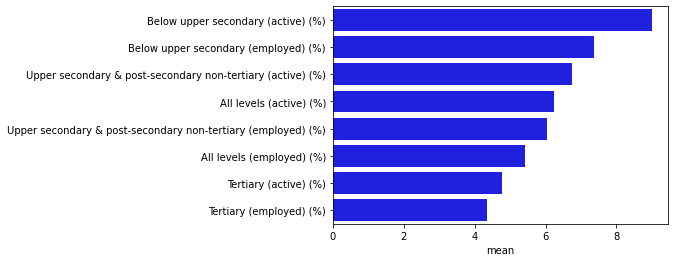

In [94]:
df = df1_edu_mean.drop(df1_edu_mean.index[[0, 3, 6, 9, 12]]).sort_values('mean',ascending=False)
sns.barplot(x='mean', y=df.index, data=df, color='b')

* Lower education tend to higher precalence in depression.  

### Let's combine all data in 2014 together. 

In [95]:
# filter 2014 data in df_merged (incluse typs and suicide data)
df1 = df_merged[df_merged.index.get_level_values('Year').isin([2014])]
df1.head()

,,,Schizophrenia (%),Bipolar disorder (%),Eating disorders (%),Anxiety disorders (%),Drug use disorders (%),Depression (%),Alcohol use disorders (%),"Suicide rate (deaths per 100,000 individuals)","Depressive disorder rates (number suffering per 100,000)",Population
Entity,Code,Year,,,,,,,,,,
Afghanistan,AFG,2014,0.165742,0.706876,0.103137,4.872256,2.562885,4.133526,0.662447,9.346731,4047.328640,33371000.0
Albania,ALB,2014,0.200392,0.703970,0.169410,3.389319,0.510089,2.203684,1.851517,5.216570,2102.818645,2896000.0
Algeria,DZA,2014,0.197602,0.817380,0.209960,5.054674,1.703742,3.629490,0.665685,4.329457,3420.953328,38924000.0
American Samoa,ASM,2014,0.249170,0.468481,0.179621,3.316431,0.768486,2.937324,1.140782,6.684827,2817.815105,56000.0
Andorra,AND,2014,0.263791,0.963960,0.649979,5.313837,0.903323,3.728379,1.248614,8.083800,3418.219621,79000.0


In [96]:
# filter 2014 data in age dataframe
df2 = df1_age[df1_age['Year'] == 2014]
df2.head()

,Entity,Code,Year,10-14 years old (%),15-19 years old (%),20-24 years old (%),25-29 years old (%),30-34 years old (%),15-49 years old (%),50-69 years old (%),70+ years old (%),All ages (%),Age-standardized (%)
24,Afghanistan,AFG,2014,1.588312,3.404254,4.398847,5.105584,5.777321,5.040517,6.092748,5.235708,3.008458,4.133526
52,Albania,ALB,2014,0.901766,2.027576,2.465396,2.399155,2.418000,2.488041,3.614356,4.357299,2.547671,2.203684
80,Algeria,DZA,2014,1.741103,3.357663,3.811391,4.218791,4.608133,4.440873,5.373814,4.825302,3.630655,3.629490
108,American Samoa,ASM,2014,1.073014,2.458926,2.910427,2.870504,2.968152,3.136965,5.416001,5.735566,2.707696,2.937324
136,Andean Latin America,NaN,2014,1.018575,2.325247,2.856305,2.915325,2.957104,2.940208,4.422511,4.729428,2.503043,2.604564


In [97]:
# filter 2014 data in gender dataframe
df3 = df1_gender[df1_gender['Year'] == 2014]
df3.head()

,Entity,Code,Year,Prevalence in males (%),Prevalence in females (%),Population
24,Afghanistan,AFG,2014,3.567284,4.690456,33371000
52,Albania,ALB,2014,1.645396,2.742312,2896000
80,Algeria,DZA,2014,2.939142,4.314927,38924000
108,American Samoa,ASM,2014,2.451986,3.402638,56000
136,Andorra,AND,2014,2.777224,4.692458,79000


In [101]:
# merge all dataframes 
df2_2 = df2.set_index(['Entity', 'Code', 'Year'])
df3_2 = df3.set_index(['Entity', 'Code','Year'])
df4 = df1_edu_2014.set_index(['Entity', 'Code','Year'])
data_frames = [df1, df2_2, df3_2, df4]
df_merged_2014 = pd.concat(data_frames, join='outer', axis=1).fillna(np.nan)
df_merged_2014.head()

,,,Schizophrenia (%),Bipolar disorder (%),Eating disorders (%),Anxiety disorders (%),Drug use disorders (%),Depression (%),Alcohol use disorders (%),"Suicide rate (deaths per 100,000 individuals)","Depressive disorder rates (number suffering per 100,000)",Population,...,All levels (total) (%),Below upper secondary (active) (%),Below upper secondary (employed) (%),Below upper secondary (total) (%),Tertiary (active) (%),Tertiary (employed) (%),Tertiary (total) (%),Upper secondary & post-secondary non-tertiary (active) (%),Upper secondary & post-secondary non-tertiary (employed) (%),Upper secondary & post-secondary non-tertiary (total) (%)
Entity,Code,Year,,,,,,,,,,,,,,,,,,,,,
Afghanistan,AFG,2014,0.165742,0.706876,0.103137,4.872256,2.562885,4.133526,0.662447,9.346731,4047.328640,33371000.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Albania,ALB,2014,0.200392,0.703970,0.169410,3.389319,0.510089,2.203684,1.851517,5.216570,2102.818645,2896000.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Algeria,DZA,2014,0.197602,0.817380,0.209960,5.054674,1.703742,3.629490,0.665685,4.329457,3420.953328,38924000.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
American Samoa,ASM,2014,0.249170,0.468481,0.179621,3.316431,0.768486,2.937324,1.140782,6.684827,2817.815105,56000.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Andean Latin America,NaN,2014,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [102]:
df_merged_2014.info()

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 232 entries, ('Afghanistan', 'AFG', 2014) to ('Zimbabwe', 'ZWE', 2014)
Data columns (total 35 columns):
 #   Column                                                        Non-Null Count  Dtype  
---  ------                                                        --------------  -----  
 0   Schizophrenia (%)                                             196 non-null    float64
 1   Bipolar disorder (%)                                          196 non-null    float64
 2   Eating disorders (%)                                          196 non-null    float64
 3   Anxiety disorders (%)                                         196 non-null    float64
 4   Drug use disorders (%)                                        196 non-null    float64
 5   Depression (%)                                                196 non-null    float64
 6   Alcohol use disorders (%)                                     196 non-null    float64
 7   Suicide rate (deaths p

In [103]:
df_merged_2014.dropna(inplace=True)
df_merged_2014.info()

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 25 entries, ('Austria', 'AUT', 2014) to ('United Kingdom', 'GBR', 2014)
Data columns (total 35 columns):
 #   Column                                                        Non-Null Count  Dtype  
---  ------                                                        --------------  -----  
 0   Schizophrenia (%)                                             25 non-null     float64
 1   Bipolar disorder (%)                                          25 non-null     float64
 2   Eating disorders (%)                                          25 non-null     float64
 3   Anxiety disorders (%)                                         25 non-null     float64
 4   Drug use disorders (%)                                        25 non-null     float64
 5   Depression (%)                                                25 non-null     float64
 6   Alcohol use disorders (%)                                     25 non-null     float64
 7   Suicide rate (deaths 

In [104]:
df_merged_2014.head()

,,,Schizophrenia (%),Bipolar disorder (%),Eating disorders (%),Anxiety disorders (%),Drug use disorders (%),Depression (%),Alcohol use disorders (%),"Suicide rate (deaths per 100,000 individuals)","Depressive disorder rates (number suffering per 100,000)",Population,...,All levels (total) (%),Below upper secondary (active) (%),Below upper secondary (employed) (%),Below upper secondary (total) (%),Tertiary (active) (%),Tertiary (employed) (%),Tertiary (total) (%),Upper secondary & post-secondary non-tertiary (active) (%),Upper secondary & post-secondary non-tertiary (employed) (%),Upper secondary & post-secondary non-tertiary (total) (%)
Entity,Code,Year,,,,,,,,,,,,,,,,,,,,,
Austria,AUT,2014,0.256479,0.939861,0.673911,5.347641,0.912597,3.267460,1.906362,11.841427,3000.146354,8615000.0,...,7.7,15.5,9.0,15.2,4.3,3.5,5.5,5.5,4.2,6.7
Belgium,BEL,2014,0.257537,0.946013,0.595100,5.207286,0.817974,4.110472,1.452881,15.070784,3741.771730,11221000.0,...,7.1,7.1,4.8,11.6,3.7,3.3,4.2,5.7,5.0,7.5
Czech Republic,CZE,2014,0.209365,0.720872,0.239664,3.448396,0.931800,2.690526,2.129813,11.466955,2526.613082,10591000.0,...,4.0,2.1,2.5,6.0,1.7,1.7,2.0,3.5,3.0,4.4
Denmark,DNK,2014,0.254513,1.005456,0.540403,5.316366,0.869327,3.277973,1.772537,8.666310,3021.897885,5664000.0,...,8.3,10.4,6.5,15.5,5.7,4.7,6.7,7.4,6.9,8.8
Estonia,EST,2014,0.203149,0.708245,0.251934,2.965608,1.133075,3.902099,4.912332,13.931776,3609.760830,1316000.0,...,5.1,4.7,4.7,6.4,3.6,3.6,4.3,3.7,3.8,5.2


ValueError: could not broadcast input array from shape (25) into shape (2)

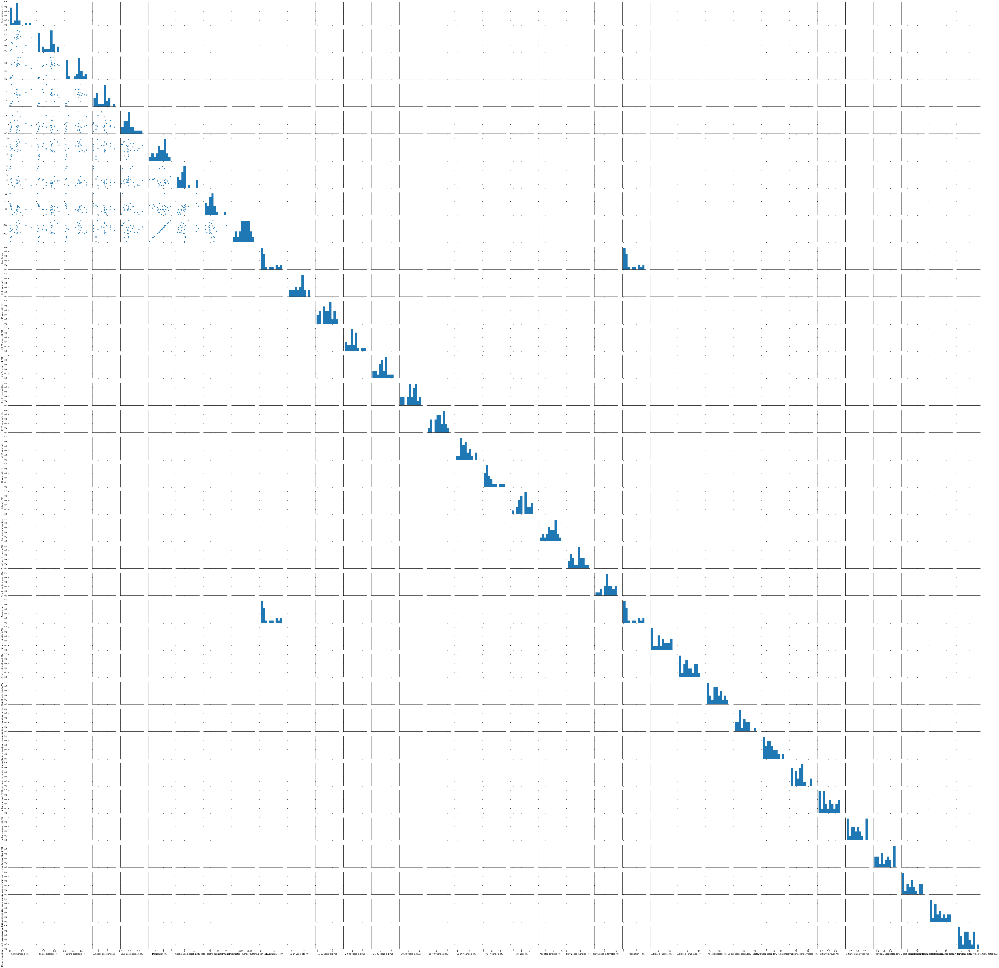

In [109]:
sns.pairplot(df_merged_2014)
plt.tight_layout()

In [107]:
df_merged_2014.shape

(25, 35)

## The relationship between mental health disorder and unemployment rate and GDP per capita 
I found another dataset from https://figshare.com/articles/Suicide_mental_health_economic_statistics/7239857. 
The dataset contains data on world suicide rate (per 100 000 people, 2000, 2005, 2010, 2016 years), mental disorders rate (population%, 2017), share of population with substance use disorders (population%, 1990-2016), GDP per capita by PPP (current US$, 1990-2017), adjusted net national income per capita (current US, 2016) and unemployment rate (population %, 1991-2017), which are then analysed and compared by country. 
#### Let's look at the GDP per capita by PPP and unemployment rate data first. 

In [110]:
df2_unemployment = pd.read_excel('Mental health_1/Unemployment worldbank 1991-2017.xlsx', skiprows=4)

In [111]:
df2_unemployment.head()

,Country Name,Country Code,Indicator Name,Indicator Code,1991,1992,1993,1994,1995,1996,...,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017
0,Aruba,ABW,"Unemployment, total (% of total labor force) (...",SL.UEM.TOTL.ZS,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Afghanistan,AFG,"Unemployment, total (% of total labor force) (...",SL.UEM.TOTL.ZS,12.0310001373291,10.6450004577637,12.3680000305176,12.298999786377,8.70199966430664,11.1379995346069,...,8.75500011444092,6.70499992370605,7.82100009918213,8.23,7.93599987030029,8.45199966430664,8.70600032806396,8.86400032043457,8.84099960327148,8.83699989318848
2,Angola,AGO,"Unemployment, total (% of total labor force) (...",SL.UEM.TOTL.ZS,23.6499996185303,23.6429996490479,23.6359996795654,23.761999130249,23.9169998168945,23.9540004730225,...,14.4989995956421,12.1370000839233,9.86299991607666,7.36,7.34700012207031,7.33099985122681,7.30600023269653,7.2810001373291,7.72399997711182,8.16699981689453
3,Albania,ALB,"Unemployment, total (% of total labor force) (...",SL.UEM.TOTL.ZS,22.3239994049072,22.6469993591309,24.826000213623,24.5830001831055,23.8610000610352,23.3980007171631,...,13.0500001907349,13.7600002288818,14.1999998092651,13.98,13.4399995803833,15.6400003433228,17.4899997711182,17.0799999237061,15.2200002670288,13.8669996261597
4,Andorra,AND,"Unemployment, total (% of total labor force) (...",SL.UEM.TOTL.ZS,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [112]:
df2_unemployment['Indicator Name'].unique()

array(['Unemployment, total (% of total labor force) (modeled ILO estimate)'],
      dtype=object)

In [113]:
df2_unemployment['Indicator Code'].unique()

array(['SL.UEM.TOTL.ZS', nan], dtype=object)

In [114]:
# drop 'Indicator Name', 'Indicator Code' unique value columns
df2_unemployment.drop(['Indicator Name', 'Indicator Code'], inplace=True,axis=1)

In [115]:
df2_unemployment.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 264 entries, 0 to 263
Data columns (total 29 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Country Name  264 non-null    object 
 1   Country Code  264 non-null    object 
 2   1991          233 non-null    object 
 3   1992          233 non-null    object 
 4   1993          233 non-null    object 
 5   1994          233 non-null    object 
 6   1995          233 non-null    object 
 7   1996          233 non-null    object 
 8   1997          233 non-null    object 
 9   1998          233 non-null    object 
 10  1999          233 non-null    object 
 11  2000          233 non-null    object 
 12  2001          233 non-null    float64
 13  2002          233 non-null    object 
 14  2003          233 non-null    object 
 15  2004          233 non-null    object 
 16  2005          233 non-null    object 
 17  2006          233 non-null    object 
 18  2007          233 non-null    

In [116]:
df2_unemployment.dropna(how='all', inplace=True)

In [117]:
# change the dtype of columns
cols = df2_unemployment.columns.drop(['Country Name', 'Country Code'])
df2_unemployment[cols] = df2_unemployment[cols].apply(pd.to_numeric, errors='coerce')

In [119]:
# fill null value with forward method
df2_unemployment.fillna(method='ffill', inplace=True)

In [120]:
df2_unemployment.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 264 entries, 0 to 263
Data columns (total 29 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Country Name  264 non-null    object 
 1   Country Code  264 non-null    object 
 2   1991          263 non-null    float64
 3   1992          263 non-null    float64
 4   1993          263 non-null    float64
 5   1994          263 non-null    float64
 6   1995          263 non-null    float64
 7   1996          263 non-null    float64
 8   1997          263 non-null    float64
 9   1998          263 non-null    float64
 10  1999          263 non-null    float64
 11  2000          263 non-null    float64
 12  2001          263 non-null    float64
 13  2002          263 non-null    float64
 14  2003          263 non-null    float64
 15  2004          263 non-null    float64
 16  2005          263 non-null    float64
 17  2006          263 non-null    float64
 18  2007          263 non-null    

In [147]:
# convert columns to rows
df2_unemployment = pd.melt(df2_unemployment, id_vars=["Country Name", 'Country Code'], var_name="Year", value_name="UnemploymentRate(%)")
df2_unemployment = df2_unemployment_2.sort_values(by=["Country Name", 'Year']).reset_index(drop=True)
df2_unemployment.head()

,Country Name,Country Code,Year,UnemploymentRate(%)
0,Afghanistan,AFG,1991,12.031
1,Afghanistan,AFG,1992,10.645
2,Afghanistan,AFG,1993,12.368
3,Afghanistan,AFG,1994,12.299
4,Afghanistan,AFG,1995,8.702


In [148]:
df2_unemployment.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7128 entries, 0 to 7127
Data columns (total 4 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Country Name         7128 non-null   object 
 1   Country Code         7128 non-null   object 
 2   Year                 7128 non-null   object 
 3   UnemploymentRate(%)  7101 non-null   float64
dtypes: float64(1), object(3)
memory usage: 222.9+ KB


In [149]:
df2_unemployment.fillna(method='ffill', inplace=True)

In [150]:
df2_unemployment.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7128 entries, 0 to 7127
Data columns (total 4 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Country Name         7128 non-null   object 
 1   Country Code         7128 non-null   object 
 2   Year                 7128 non-null   int64  
 3   UnemploymentRate(%)  7128 non-null   float64
dtypes: float64(1), int64(1), object(2)
memory usage: 222.9+ KB


gdp per capita ppp 1990-2017

In [122]:
xls_3 = pd.ExcelFile('Mental health_1/gdp per capita ppp 1990-2017.xls')
xls_3.sheet_names

['Data', 'Metadata - Countries', 'Metadata - Indicators']

In [123]:
df2_gdp = pd.read_excel(xls_3, 'Data', skiprows=3)

In [124]:
df2_gdp.head()

,Country Name,Country Code,Indicator Name,Indicator Code,1990,1991,1992,1993,1994,1995,...,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017
0,Aruba,ABW,"GDP per capita, PPP (current international $)",NY.GDP.PCAP.PP.CD,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,35973.780510,NaN,NaN,NaN,NaN,NaN,NaN
1,Afghanistan,AFG,"GDP per capita, PPP (current international $)",NY.GDP.PCAP.PP.CD,NaN,NaN,NaN,NaN,NaN,NaN,...,1247.066144,1482.098837,1581.600836,1660.739856,1873.153946,1913.160644,1937.235365,1926.357336,1944.117005,1980.516177
2,Angola,AGO,"GDP per capita, PPP (current international $)",NY.GDP.PCAP.PP.CD,2217.438380,2243.546096,2091.590164,1574.909779,1578.440193,1797.522525,...,5743.098881,5718.685523,5778.380803,5911.254092,6110.423392,6403.767556,6591.538820,6631.618694,6440.990242,6388.960022
3,Albania,ALB,"GDP per capita, PPP (current international $)",NY.GDP.PCAP.PP.CD,2722.280344,1992.560528,1902.751280,2148.099954,2390.531021,2782.093734,...,8228.337106,8813.252003,9637.345368,10207.764699,10526.241215,10570.952998,11259.264500,11334.220932,11559.300844,12020.690732
4,Andorra,AND,"GDP per capita, PPP (current international $)",NY.GDP.PCAP.PP.CD,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [125]:
df2_gdp.dropna(how='all', inplace=True)
df2_gdp.fillna(method='ffill', inplace=True)

In [126]:
df2_gdp.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 264 entries, 0 to 263
Data columns (total 32 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Country Name    264 non-null    object 
 1   Country Code    264 non-null    object 
 2   Indicator Name  264 non-null    object 
 3   Indicator Code  264 non-null    object 
 4   1990            262 non-null    float64
 5   1991            262 non-null    float64
 6   1992            262 non-null    float64
 7   1993            262 non-null    float64
 8   1994            262 non-null    float64
 9   1995            262 non-null    float64
 10  1996            262 non-null    float64
 11  1997            262 non-null    float64
 12  1998            262 non-null    float64
 13  1999            262 non-null    float64
 14  2000            262 non-null    float64
 15  2001            262 non-null    float64
 16  2002            263 non-null    float64
 17  2003            263 non-null    flo

In [127]:
df2_gdp.head()

,Country Name,Country Code,Indicator Name,Indicator Code,1990,1991,1992,1993,1994,1995,...,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017
0,Aruba,ABW,"GDP per capita, PPP (current international $)",NY.GDP.PCAP.PP.CD,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,35973.780510,NaN,NaN,NaN,NaN,NaN,NaN
1,Afghanistan,AFG,"GDP per capita, PPP (current international $)",NY.GDP.PCAP.PP.CD,NaN,NaN,NaN,NaN,NaN,NaN,...,1247.066144,1482.098837,1581.600836,1660.739856,1873.153946,1913.160644,1937.235365,1926.357336,1944.117005,1980.516177
2,Angola,AGO,"GDP per capita, PPP (current international $)",NY.GDP.PCAP.PP.CD,2217.438380,2243.546096,2091.590164,1574.909779,1578.440193,1797.522525,...,5743.098881,5718.685523,5778.380803,5911.254092,6110.423392,6403.767556,6591.538820,6631.618694,6440.990242,6388.960022
3,Albania,ALB,"GDP per capita, PPP (current international $)",NY.GDP.PCAP.PP.CD,2722.280344,1992.560528,1902.751280,2148.099954,2390.531021,2782.093734,...,8228.337106,8813.252003,9637.345368,10207.764699,10526.241215,10570.952998,11259.264500,11334.220932,11559.300844,12020.690732
4,Andorra,AND,"GDP per capita, PPP (current international $)",NY.GDP.PCAP.PP.CD,2722.280344,1992.560528,1902.751280,2148.099954,2390.531021,2782.093734,...,8228.337106,8813.252003,9637.345368,10207.764699,10526.241215,10570.952998,11259.264500,11334.220932,11559.300844,12020.690732


In [128]:
df2_gdp.fillna(method='bfill', inplace=True)

In [129]:
df2_gdp.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 264 entries, 0 to 263
Data columns (total 32 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Country Name    264 non-null    object 
 1   Country Code    264 non-null    object 
 2   Indicator Name  264 non-null    object 
 3   Indicator Code  264 non-null    object 
 4   1990            264 non-null    float64
 5   1991            264 non-null    float64
 6   1992            264 non-null    float64
 7   1993            264 non-null    float64
 8   1994            264 non-null    float64
 9   1995            264 non-null    float64
 10  1996            264 non-null    float64
 11  1997            264 non-null    float64
 12  1998            264 non-null    float64
 13  1999            264 non-null    float64
 14  2000            264 non-null    float64
 15  2001            264 non-null    float64
 16  2002            264 non-null    float64
 17  2003            264 non-null    flo

In [130]:
# income level
df2_gdpgroup = pd.read_excel(xls_3, 'Metadata - Countries')

In [131]:
df2_gdpgroup.head()

,Country Code,Region,IncomeGroup,SpecialNotes,TableName
0,ABW,Latin America & Caribbean,High income,SNA data for 2000-2011 are updated from offici...,Aruba
1,AFG,South Asia,Low income,Fiscal year end: March 20; reporting period fo...,Afghanistan
2,AGO,Sub-Saharan Africa,Lower middle income,NaN,Angola
3,ALB,Europe & Central Asia,Upper middle income,NaN,Albania
4,AND,Europe & Central Asia,High income,WB-3 code changed from ADO to AND to align wit...,Andorra


In [132]:
df2_gdpgroup.rename(columns={'TableName':'Country Name'}, inplace=True)

In [133]:
df2_gdp_merged = pd.merge(df2_gdp, df2_gdpgroup, on='Country Name', how='outer')

In [134]:
df2_gdp_merged.head()

,Country Name,Country Code_x,Indicator Name,Indicator Code,1990,1991,1992,1993,1994,1995,...,2012,2013,2014,2015,2016,2017,Country Code_y,Region,IncomeGroup,SpecialNotes
0,Aruba,ABW,"GDP per capita, PPP (current international $)",NY.GDP.PCAP.PP.CD,2217.438380,2243.546096,2091.590164,1574.909779,1578.440193,1797.522525,...,1873.153946,1913.160644,1937.235365,1926.357336,1944.117005,1980.516177,ABW,Latin America & Caribbean,High income,SNA data for 2000-2011 are updated from offici...
1,Afghanistan,AFG,"GDP per capita, PPP (current international $)",NY.GDP.PCAP.PP.CD,2217.438380,2243.546096,2091.590164,1574.909779,1578.440193,1797.522525,...,1873.153946,1913.160644,1937.235365,1926.357336,1944.117005,1980.516177,AFG,South Asia,Low income,Fiscal year end: March 20; reporting period fo...
2,Angola,AGO,"GDP per capita, PPP (current international $)",NY.GDP.PCAP.PP.CD,2217.438380,2243.546096,2091.590164,1574.909779,1578.440193,1797.522525,...,6110.423392,6403.767556,6591.538820,6631.618694,6440.990242,6388.960022,AGO,Sub-Saharan Africa,Lower middle income,NaN
3,Albania,ALB,"GDP per capita, PPP (current international $)",NY.GDP.PCAP.PP.CD,2722.280344,1992.560528,1902.751280,2148.099954,2390.531021,2782.093734,...,10526.241215,10570.952998,11259.264500,11334.220932,11559.300844,12020.690732,ALB,Europe & Central Asia,Upper middle income,NaN
4,Andorra,AND,"GDP per capita, PPP (current international $)",NY.GDP.PCAP.PP.CD,2722.280344,1992.560528,1902.751280,2148.099954,2390.531021,2782.093734,...,10526.241215,10570.952998,11259.264500,11334.220932,11559.300844,12020.690732,AND,Europe & Central Asia,High income,WB-3 code changed from ADO to AND to align wit...


In [135]:
df2_gdp_merged.drop(['Indicator Name', 'Indicator Code', 'Country Code_y', 'SpecialNotes'], inplace=True,axis=1)

In [139]:
df2_gdp_merged.rename(columns={'Country Code_x':'Country Code'}, inplace=True)
df2_gdp_merged.head()

,Country Name,Country Code,1990,1991,1992,1993,1994,1995,1996,1997,...,2010,2011,2012,2013,2014,2015,2016,2017,Region,IncomeGroup
0,Aruba,ABW,2217.438380,2243.546096,2091.590164,1574.909779,1578.440193,1797.522525,2019.744617,2144.35083,...,1581.600836,35973.780510,1873.153946,1913.160644,1937.235365,1926.357336,1944.117005,1980.516177,Latin America & Caribbean,High income
1,Afghanistan,AFG,2217.438380,2243.546096,2091.590164,1574.909779,1578.440193,1797.522525,2019.744617,2144.35083,...,1581.600836,1660.739856,1873.153946,1913.160644,1937.235365,1926.357336,1944.117005,1980.516177,South Asia,Low income
2,Angola,AGO,2217.438380,2243.546096,2091.590164,1574.909779,1578.440193,1797.522525,2019.744617,2144.35083,...,5778.380803,5911.254092,6110.423392,6403.767556,6591.538820,6631.618694,6440.990242,6388.960022,Sub-Saharan Africa,Lower middle income
3,Albania,ALB,2722.280344,1992.560528,1902.751280,2148.099954,2390.531021,2782.093734,3109.943347,2838.04492,...,9637.345368,10207.764699,10526.241215,10570.952998,11259.264500,11334.220932,11559.300844,12020.690732,Europe & Central Asia,Upper middle income
4,Andorra,AND,2722.280344,1992.560528,1902.751280,2148.099954,2390.531021,2782.093734,3109.943347,2838.04492,...,9637.345368,10207.764699,10526.241215,10570.952998,11259.264500,11334.220932,11559.300844,12020.690732,Europe & Central Asia,High income


In [142]:
df2_gdp_merged = pd.melt(df2_gdp_merged, id_vars=["Country Name", 'Country Code', 'Region', 'IncomeGroup'], var_name="Year", value_name="GDP_per_capita($)")
df2_gdp_merged = df2_gdp_merged_2.sort_values(by=["Country Name", 'Year']).reset_index(drop=True)
df2_gdp_merged.head()

,Country Name,Country Code,Region,IncomeGroup,Year,GDP_per_capita($)
0,Afghanistan,AFG,South Asia,Low income,1990,2217.438380
1,Afghanistan,AFG,South Asia,Low income,1991,2243.546096
2,Afghanistan,AFG,South Asia,Low income,1992,2091.590164
3,Afghanistan,AFG,South Asia,Low income,1993,1574.909779
4,Afghanistan,AFG,South Asia,Low income,1994,1578.440193


In [143]:
df2_gdp_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7644 entries, 0 to 7643
Data columns (total 6 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Country Name       7644 non-null   object 
 1   Country Code       7392 non-null   object 
 2   Region             6076 non-null   object 
 3   IncomeGroup        6076 non-null   object 
 4   Year               7644 non-null   object 
 5   GDP_per_capita($)  7392 non-null   float64
dtypes: float64(1), object(5)
memory usage: 358.4+ KB


In [151]:
df2_gdp_merged.fillna(method='ffill', inplace=True)
df2_gdp_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7644 entries, 0 to 7643
Data columns (total 6 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Country Name       7644 non-null   object 
 1   Country Code       7644 non-null   object 
 2   Region             7644 non-null   object 
 3   IncomeGroup        7644 non-null   object 
 4   Year               7644 non-null   object 
 5   GDP_per_capita($)  7644 non-null   float64
dtypes: float64(1), object(5)
memory usage: 358.4+ KB


### Merge dataframes-- df_merged (incluse typs and suicide data), df2_unemployment, df2_gdp_merged

In [152]:
df_merged.head()

Schizophrenia (%)  Bipolar disorder (%)  \
Entity      Code Year                                            
Afghanistan AFG  1990           0.160560              0.697779   
                 1991           0.160312              0.697961   
                 1992           0.160135              0.698107   
                 1993           0.160037              0.698257   
                 1994           0.160022              0.698469   

                       Eating disorders (%)  Anxiety disorders (%)  \
Entity      Code Year                                                
Afghanistan AFG  1990              0.101855               4.828830   
                 1991              0.099313               4.829740   
                 1992              0.096692               4.831108   
                 1993              0.094336               4.830864   
                 1994              0.092439               4.829423   

                       Drug use disorders (%)  Depression (%)  \
Entity      Code Year                                           
Afghanistan AFG  1990                1.677082        4.071831   
                 1991                1.684746        4.079531   
                 1992                1.694334        4.088358   
                 1993                1.705320        4.096190   
                 1994                1.716069        4.099582   

                       Alcohol use disorders (%)  \
Entity      Code Year                              
Afghanistan AFG  1990                   0.672404   
                 1991                   0.671768   
                 1992                   0.670644   
                 1993                   0.669738   
                 1994                   0.669260   

                       Suicide rate (deaths per 100,000 individuals)  \
Entity      Code Year                                                  
Afghanistan AFG  1990                                      10.318504   
                 1991                                      10.327010   
                 1992                                      10.271411   
                 1993                                      10.376123   
                 1994                                      10.575915   

                       Depressive disorder rates (number suffering per 100,000)  \
Entity      Code Year                                                             
Afghanistan AFG  1990                                        4039.755763          
                 1991                                        4046.256034          
                 1992                                        4053.709902          
                 1993                                        4060.203474          
                 1994                                        4062.290365          

                       Population  
Entity      Code Year              
Afghanistan AFG  1990  12412000.0  
                 1991  13299000.0  
                 1992  14486000.0  
                 1993  15817000.0  
                 1994  17076000.0

In [154]:
df2_unemployment.head()

,Country Name,Country Code,Year,UnemploymentRate(%)
0,Afghanistan,AFG,1991,12.031
1,Afghanistan,AFG,1992,10.645
2,Afghanistan,AFG,1993,12.368
3,Afghanistan,AFG,1994,12.299
4,Afghanistan,AFG,1995,8.702


In [156]:
df2_gdp_merged.head()

,Country Name,Country Code,Region,IncomeGroup,Year,GDP_per_capita($)
0,Afghanistan,AFG,South Asia,Low income,1990,2217.438380
1,Afghanistan,AFG,South Asia,Low income,1991,2243.546096
2,Afghanistan,AFG,South Asia,Low income,1992,2091.590164
3,Afghanistan,AFG,South Asia,Low income,1993,1574.909779
4,Afghanistan,AFG,South Asia,Low income,1994,1578.440193


In [157]:
# Change the name of column to be the same
df2_unemployment.rename(columns={'Country Name':'Entity', 'Country Code': 'Code'}, inplace=True)
df2_gdp_merged.rename(columns={'Country Name':'Entity', 'Country Code': 'Code'}, inplace=True)

In [158]:
df2_unemployment.set_index(['Entity', 'Code', 'Year'], inplace=True)
df2_gdp_merged.set_index(['Entity', 'Code', 'Year'], inplace=True)

In [159]:
# Merge those dataframes
data_frames = [df_merged, df2_unemployment, df2_gdp_merged]
df = pd.concat(data_frames, join='outer', axis=1).fillna(np.nan)

In [160]:
df.head()

Schizophrenia (%)  Bipolar disorder (%)  \
Entity      Code Year                                            
Afghanistan AFG  1990           0.160560              0.697779   
                 1991           0.160312              0.697961   
                 1992           0.160135              0.698107   
                 1993           0.160037              0.698257   
                 1994           0.160022              0.698469   

                       Eating disorders (%)  Anxiety disorders (%)  \
Entity      Code Year                                                
Afghanistan AFG  1990              0.101855               4.828830   
                 1991              0.099313               4.829740   
                 1992              0.096692               4.831108   
                 1993              0.094336               4.830864   
                 1994              0.092439               4.829423   

                       Drug use disorders (%)  Depression (%)  \
Entity      Code Year                                           
Afghanistan AFG  1990                1.677082        4.071831   
                 1991                1.684746        4.079531   
                 1992                1.694334        4.088358   
                 1993                1.705320        4.096190   
                 1994                1.716069        4.099582   

                       Alcohol use disorders (%)  \
Entity      Code Year                              
Afghanistan AFG  1990                   0.672404   
                 1991                   0.671768   
                 1992                   0.670644   
                 1993                   0.669738   
                 1994                   0.669260   

                       Suicide rate (deaths per 100,000 individuals)  \
Entity      Code Year                                                  
Afghanistan AFG  1990                                      10.318504   
                 1991                                      10.327010   
                 1992                                      10.271411   
                 1993                                      10.376123   
                 1994                                      10.575915   

                       Depressive disorder rates (number suffering per 100,000)  \
Entity      Code Year                                                             
Afghanistan AFG  1990                                        4039.755763          
                 1991                                        4046.256034          
                 1992                                        4053.709902          
                 1993                                        4060.203474          
                 1994                                        4062.290365          

                       Population  UnemploymentRate(%) Region IncomeGroup  \
Entity      Code Year                                                       
Afghanistan AFG  1990  12412000.0                  NaN    NaN         NaN   
                 1991  13299000.0               12.031    NaN         NaN   
                 1992  14486000.0               10.645    NaN         NaN   
                 1993  15817000.0               12.368    NaN         NaN   
                 1994  17076000.0               12.299    NaN         NaN   

                       GDP_per_capita($)  
Entity      Code Year                     
Afghanistan AFG  1990                NaN  
                 1991                NaN  
                 1992                NaN  
                 1993                NaN  
                 1994                NaN

In [161]:
df.info()

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 15508 entries, ('Afghanistan', 'AFG', 1990) to ('Zimbabwe', 'ZWE', '2017')
Data columns (total 14 columns):
 #   Column                                                    Non-Null Count  Dtype  
---  ------                                                    --------------  -----  
 0   Schizophrenia (%)                                         5488 non-null   float64
 1   Bipolar disorder (%)                                      5488 non-null   float64
 2   Eating disorders (%)                                      5488 non-null   float64
 3   Anxiety disorders (%)                                     5488 non-null   float64
 4   Drug use disorders (%)                                    5488 non-null   float64
 5   Depression (%)                                            5488 non-null   float64
 6   Alcohol use disorders (%)                                 5488 non-null   float64
 7   Suicide rate (deaths per 100,000 individuals)         

In [162]:
pd.set_option("max_rows", None)
df

Schizophrenia (%)  \
Entity                                             Code     Year                      
Afghanistan                                        AFG      1990           0.160560   
                                                            1991           0.160312   
                                                            1992           0.160135   
                                                            1993           0.160037   
                                                            1994           0.160022   
                                                            1995           0.160076   
                                                            1996           0.160249   
                                                            1997           0.160554   
                                                            1998           0.160931   
                                                            1999           0.161311   
                                                            2000           0.161621   
                                                            2001           0.161957   
                                                            2002           0.162414   
                                                            2003           0.162916   
                                                            2004           0.163377   
                                                            2005           0.163706   
                                                            2006           0.163977   
                                                            2007           0.164302   
                                                            2008           0.164639   
                                                            2009           0.164932   
                                                            2010           0.165130   
                                                            2011           0.165272   
                                                            2012           0.165424   
                                                            2013           0.165579   
                                                            2014           0.165742   
                                                            2015           0.165895   
                                                            2016           0.166035   
                                                            2017           0.166158   
Albania                                            ALB      1990           0.193413   
                                                            1991           0.193393   
                                                            1992           0.193405   
                                                            1993           0.193438   
                                                            1994           0.193491   
                                                            1995           0.193559   
                                                            1996           0.193675   
                                                            1997           0.193865   
                                                            1998           0.194094   
                                                            1999           0.194328   
                                                            2000           0.194541   
                                                            2001           0.194812   
                                                            2002           0.195214   
                                                            2003           0.195677   
                                                            2004           0.196139   
                                                            2005           0.196538   
                                                            2006

<font color='red'>Q: The df2_gdp_merged dataframe didn't merge right. I don't know why this happend. </font> 